# **Analysis for Twain Works through Module 7 (Language Models, NLP, Vector Space Models, Similarity and Clustering, PCA)**

## **DS 5001: Exploratory Text Analytics**

## **Cecily Wolfe (cew4pf)**

## **Spring 2022**

In [1]:
# read in docs

import os
from glob import glob
import numpy as np
import pandas as pd

from textparser import TextParser

import nltk
from nltk.stem.porter import PorterStemmer
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.lancaster import LancasterStemmer

from langmod import NgramCounter
from langmod import NgramLanguageModel
import itertools

import seaborn as sns
import plotly.express as px

from numpy.linalg import norm
from scipy.spatial.distance import pdist
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from bow_tfidf_pca import create_bow, get_tfidf, get_pca
from prince import PCA

In [2]:
sns.set()

In [3]:
OHCO = ["book_id", "chap_id", "para_num", "sent_num", "token_num"]

In [4]:
SENTS = OHCO[:4]
PARAS = OHCO[:3]
CHAPS = OHCO[:2]
BOOKS = OHCO[:1]

In [5]:
LIB = pd.read_csv("twain_pre_LIB.csv").set_index(BOOKS).sort_index()

In [6]:
CORPUS = pd.read_csv("twain_pre_CORPUS.csv").set_index(OHCO)

# remove NaN values
CORPUS = CORPUS[~CORPUS.term_str.isna()]

In [7]:
VOCAB = pd.read_csv("twain_pre_VOCAB.csv")

VOCAB['term_str'] = VOCAB['term_str'].astype('str')

VOCAB = VOCAB.set_index('term_str')

In [8]:
VOCAB

,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,
0,5,1,1.683290e-06,19.180285,CD,1,{'CD'},0,0,0,0
00,3,2,1.009974e-06,19.917251,NN,2,"{'NN', 'NNS'}",0,00,00,00
01,3,2,1.009974e-06,19.917251,NNS,2,"{'NN', 'NNS'}",0,01,01,01
02,4,2,1.346632e-06,19.502213,NN,3,"{'POS', 'NN', 'NNP'}",0,02,02,02
03,6,2,2.019948e-06,18.917251,NN,3,"{'POS', 'NN', 'NNS'}",0,03,03,03
...,...,...,...,...,...,...,...,...,...,...,...
êtes,1,4,3.366579e-07,21.502213,NNS,1,{'NNS'},0,ête,êtes,ête
être,3,4,1.009974e-06,19.917251,NNP,2,"{'JJ', 'NNP'}",0,être,être,être
öffnen,1,6,3.366579e-07,21.502213,NN,1,{'NN'},0,öffnen,öffnen,öffnen


In [9]:
LIB

,source_file_path,title,chap_regex,author,type,year,decade,n_chaps,book_len
book_id,,,,,,,,,
70,Twain/70-what_is_man.txt,what is man,WHAT IS MAN?|THE DEATH OF JEAN|THE TURNING-POI...,twain,non-fiction,1906,1900,17,96111
74,Twain/74-the_adventures_of_tom_sawyer.txt,the adventures of tom sawyer,^\s*CHAPTER\s*[IVXLCM]+$,twain,novel,1876,1870,35,70276
76,Twain/76-the_adventures_of_huckleberry_finn.txt,the adventures of huckleberry finn,^\s*CHAPTER\s*(?:[IVXLCM]+\.|THE LAST)$,twain,novel,1884,1880,43,111908
86,Twain/86-a_connecticut_yankee_in_king_arthurs_...,a connecticut yankee in king arthurs court,^\s*(?:PREFACE|A WORD OF EXPLANATION|THE STRAN...,twain,novel,1889,1880,47,119100
91,Twain/91-tom_sawyer_abroad.txt,tom sawyer abroad,CHAPTER\s[IVXLCM]+\.,twain,novel,1894,1890,13,33969
93,Twain/93-tom_sawyer_detective.txt,tom sawyer detective,^CHAPTER\s[IVXLCM]+\.\s[A-Z],twain,novel,1896,1890,11,23372
102,Twain/102-the_tragedy_of_puddnhead_wilson.txt,the tragedy of puddnhead wilson,^(?:A Whisper|CHAPTER\s[IVXLCM]+\.|CONCLUSION)$,twain,novel,1894,1890,22,53935
119,Twain/119-a_tramp_abroad.txt,a tramp abroad,^(?:CHAPTER\s[IVXLCM]+|APPENDIX\s[A-Z]\.)$,twain,non-fiction,1880,1880,55,159402
142,Twain/142-the_30000_bequest_and_other_stories.txt,the 30000 bequest and other stories,"THE \$30,000 BEQUEST$|A DOG'S TALE$|WAS IT HEA...",twain,stories,1906,1900,25,93670


In [10]:
CORPUS

pos_tuple  pos  \
book_id chap_id para_num sent_num token_num                               
70      1       1        0        0                   ('By', 'IN')   IN   
                                  1                ('Mark', 'NNP')  NNP   
                                  2               ('Twain', 'NNP')  NNP   
                2        0        0              ('(Samuel', 'JJ')   JJ   
                                  1           ('Langhorne', 'NNP')  NNP   
...                                                            ...  ...   
62739   6       13       0        8           ("Leopold's", 'NNP')  NNP   
                                  9          ('Soliloquy,', 'NNP')  NNP   
                                  10                  ('by', 'IN')   IN   
                                  11               ('Mark', 'NNP')  NNP   
                                  12              ('Twain', 'NNP')  NNP   

                                              token_str   term_str  
book_id chap_id para_num sent_num token_num                         
70      1       1        0        0                  By         by  
                                  1                Mark       mark  
                                  2               Twain      twain  
                2        0        0             (Samuel     samuel  
                                  1           Langhorne  langhorne  
...                                                 ...        ...  
62739   6       13       0        8           Leopold's   leopolds  
                                  9          Soliloquy,  soliloquy  
                                  10                 by         by  
                                  11               Mark       mark  
                                  12              Twain      twain  

[2970356 rows x 4 columns]

## **M03: Language Models**

### **Create Training Vocab ($V_{train}$)**

In [11]:
V_TRAIN = sorted(list(set(VOCAB.index)))

In [12]:
len(V_TRAIN)

53853

### **Generate Training Sentences**

In [13]:
# convert col type to str otherwise errors when generating training sentences
CORPUS['term_str'] = CORPUS.term_str.astype('str')
CORPUS['token_str'] = CORPUS.term_str.astype('str')

In [14]:
S_TRAIN = list(CORPUS.groupby(OHCO[:-1]).term_str.apply(lambda x: ' '.join(x)).values)

In [15]:
len(S_TRAIN)

155621

In [16]:
S_TRAIN[:5]

['by mark twain',
 'samuel langhorne clemens 1835 1910',
 'contents',
 'what is man',
 'the death of jean']

### **Generate and Count Ngrams**

In [17]:
train = NgramCounter(S_TRAIN, V_TRAIN)
train.generate()

### **n-gram token table**

In [18]:
train.I

w0     w1     w2
sent_num token_num                         
0        0                <s>    <s>     by
         1                <s>     by   mark
         2                 by   mark  twain
         3               mark  twain   </s>
         4              twain   </s>    <s>
...                       ...    ...    ...
155620   11         soliloquy     by   mark
         12                by   mark  twain
         13              mark  twain   </s>
         14             twain   </s>    NaN
         15              </s>    NaN    NaN

[3437219 rows x 3 columns]

### **Unigram table**

In [129]:
stop_words = VOCAB.loc[VOCAB.stop == 1].index.values

In [130]:
unigram_df = train.LM[0].sort_values('n', ascending = False)
unigram_df

,n,mle,p,log_p
w0,,,,
<s>,311242,9.055053e-02,9.055053e-02,-3.465133
the,161902,4.710261e-02,4.710261e-02,-4.408049
</s>,155621,4.527526e-02,4.527526e-02,-4.465133
and,128130,3.727723e-02,3.727723e-02,-4.745562
of,82827,2.409710e-02,2.409710e-02,-5.374997
...,...,...,...,...
jumieges,1,2.909329e-07,2.909329e-07,-21.712810
jument,1,2.909329e-07,2.909329e-07,-21.712810
jumblings,1,2.909329e-07,2.909329e-07,-21.712810


In [131]:
unigram_df.filter(regex = '^[^<]', axis = 0)

,n,mle,p,log_p
w0,,,,
the,161902,4.710261e-02,4.710261e-02,-4.408049
and,128130,3.727723e-02,3.727723e-02,-4.745562
of,82827,2.409710e-02,2.409710e-02,-5.374997
a,76650,2.230000e-02,2.230000e-02,-5.486812
to,75666,2.201373e-02,2.201373e-02,-5.505453
...,...,...,...,...
jumieges,1,2.909329e-07,2.909329e-07,-21.712810
jument,1,2.909329e-07,2.909329e-07,-21.712810
jumblings,1,2.909329e-07,2.909329e-07,-21.712810


### **Bigram table**

In [132]:
bigram_df = train.LM[1].sort_values('n', ascending = False)
bigram_df

n           mle      mle2         p      log_p
w0             w1                                                       
<s>            <s>   155621  4.527528e-02  0.500000  0.426250  -1.230230
</s>           <s>   155620  4.527499e-02  0.999994  0.742910  -0.428741
of             the    18933  5.508234e-03  0.228585  0.138527  -2.851762
<s>            i      14638  4.258677e-03  0.047031  0.040096  -4.640387
in             the    14055  4.089063e-03  0.277954  0.134610  -2.893140
...                     ...           ...       ...       ...        ...
hillfor        just       1  2.909330e-07  1.000000  0.000037 -14.716793
hillock        at         1  2.909330e-07  0.333333  0.000037 -14.716846
               five       1  2.909330e-07  0.333333  0.000037 -14.716846
               he         1  2.909330e-07  0.333333  0.000037 -14.716846
übergeschlagen </s>       1  2.909330e-07  1.000000  0.000037 -14.716793

[764796 rows x 5 columns]

In [133]:
reduced_bigram = bigram_df.reset_index()

# remove spaces
reduced_bigram = reduced_bigram.loc[~((reduced_bigram.w0.str.contains('<')) | (reduced_bigram.w1.str.contains('<')))]

# remove stop words
reduced_bigram = reduced_bigram.loc[~((reduced_bigram.w0.isin(stop_words)) | (reduced_bigram.w1.isin(stop_words)))].set_index(['w0', 'w1'])

reduced_bigram

n           mle      mle2         p      log_p
w0      w1                                                         
new     york       738  2.147085e-04  0.244128  0.012993  -6.266127
mark    twain      608  1.768872e-04  0.480253  0.011049  -6.499990
years   ago        597  1.736870e-04  0.197095  0.010513  -6.571708
dont    know       506  1.472121e-04  0.158571  0.008888  -6.813971
good    deal       404  1.175369e-04  0.084149  0.006905  -7.178188
...                ...           ...       ...       ...        ...
hill    west         1  2.909330e-07  0.002618  0.000037 -14.726963
        wheeling     1  2.909330e-07  0.002618  0.000037 -14.726963
        wherewith    1  2.909330e-07  0.002618  0.000037 -14.726963
        work         1  2.909330e-07  0.002618  0.000037 -14.726963
hillock five         1  2.909330e-07  0.333333  0.000037 -14.716846

[325618 rows x 5 columns]

### **Trigram table**

In [134]:
trigram_df = train.LM[2].sort_values('n', ascending = False)
trigram_df

n           mle      mle2             p  \
w0             w1   w2                                                      
</s>           <s>  <s>      155620  4.527500e-02  1.000000  5.365485e-05   
<s>            <s>  i         14638  4.258678e-03  0.094062  5.047219e-06   
                    the       12480  3.630844e-03  0.080195  4.303186e-06   
                    it         8015  2.331828e-03  0.051503  2.763748e-06   
                    he         7764  2.258804e-03  0.049890  2.677209e-06   
...                             ...           ...       ...           ...   
harte          and  mr            1  2.909330e-07  0.250000  6.895949e-10   
                    i             1  2.909330e-07  0.250000  6.895949e-10   
                    getting       1  2.909330e-07  0.250000  6.895949e-10   
                    clemens       1  2.909330e-07  0.250000  6.895949e-10   
übergeschlagen </s> <s>           1  2.909330e-07  1.000000  6.895949e-10   

                                 log_p  
w0             w1   w2                  
</s>           <s>  <s>     -14.185932  
<s>            <s>  i       -17.596080  
                    the     -17.826163  
                    it      -18.464942  
                    he      -18.510839  
...                                ...  
harte          and  mr      -30.433532  
                    i       -30.433532  
                    getting -30.433532  
                    clemens -30.433532  
übergeschlagen </s> <s>     -30.433532  

[1914877 rows x 5 columns]

In [135]:
reduced_trigram = trigram_df.reset_index()

# remove spaces
reduced_trigram = reduced_trigram.loc[~((reduced_trigram.w0.str.contains('<')) | (reduced_trigram.w1.str.contains('<')) | (reduced_trigram.w2.str.contains('<')))]

# remove stop words
reduced_trigram = reduced_trigram.loc[~((reduced_trigram.w0.isin(stop_words)) | (reduced_trigram.w1.isin(stop_words)) | (reduced_trigram.w2.isin(stop_words)))].set_index(['w0', 'w1', 'w2'])

reduced_trigram

,,,n,mle,mle2,p,log_p
w0,w1,w2,,,,,
hundred,years,ago,76,2.211091e-05,0.288973,2.654940e-08,-25.166745
wilsons,new,calendar,74,2.152905e-05,1.000000,2.585981e-08,-25.204713
puddnhead,wilsons,new,74,2.152905e-05,0.632479,2.585981e-08,-25.204713
twenty,four,hours,70,2.036531e-05,0.569106,2.448062e-08,-25.283785
yrs,ever,mark,55,1.600132e-05,0.833333,1.930866e-08,-25.626177
...,...,...,...,...,...,...,...
harsher,methods,would,1,2.909330e-07,1.000000,6.895949e-10,-30.433532
harsh,words,troubled,1,2.909330e-07,1.000000,6.895949e-10,-30.433532
hart,came,along,1,2.909330e-07,1.000000,6.895949e-10,-30.433532


In [136]:
reduced_trigram.head(10)

,,,n,mle,mle2,p,log_p
w0,w1,w2,,,,,
hundred,years,ago,76,0.000022,0.288973,2.654940e-08,-25.166745
wilsons,new,calendar,74,0.000022,1.000000,2.585981e-08,-25.204713
puddnhead,wilsons,new,74,0.000022,0.632479,2.585981e-08,-25.204713
twenty,four,hours,70,0.000020,0.569106,2.448062e-08,-25.283785
yrs,ever,mark,55,0.000016,0.833333,1.930866e-08,-25.626177
mrs,jane,clemens,41,0.000012,1.000000,1.448149e-08,-26.041214
fifty,years,ago,38,0.000011,0.351852,1.344710e-08,-26.148130
puddnhead,wilsons,calendar,38,0.000011,0.324786,1.344710e-08,-26.148130
five,years,ago,36,0.000010,0.251748,1.275751e-08,-26.224078


In [137]:
LIB.type.value_counts()

non-fiction    17
stories        17
novel          11
Name: type, dtype: int64

### **Create language model**

In [22]:
# generate n-gram model using n-gram counter
model = NgramLanguageModel(train)

# implement smoothing (with k = 1) to prevent zero prob. for n-grams unseen in training data
model.k = 1
model.apply_smoothing()

In [23]:
# list of ngram token tables for unigram, bigram, trigram
ngram = model.NG

# list of unigram, bigram, trigram dfs with count, max likelihood estimate (MLE), joint prob, log joint prob, conditional prob, log conditional prob
LM = model.LM

Z1 = model.Z1

Z2 = model.Z2

### **Generate a text with the `.generate_text()` method of the `langmod.NgramLanguageModel` object (`model`)**

In [24]:
model.generate_text()

01. COMFORTABLE GOOD SERVICE OF ANY KIND OF FANCY PERSIAN STUFF FILLED WITH HUMAN ASPECTS REMOVED OH VERY WELL FORTIFIED WITH RESPONSIBLE APPETITES AND GODLESS ATTITUDES OF THE LITTLE CREATURES AS ALL THOSE PEOPLE A LIMPID TORRENT GOES WHISTLING DOWN THE LIGHTNING HAS STRUCK A FINAL STRUGGLE FOR INDEPENDENCE AND THAT IS YOU CANNOT SEE THE BOIL SCAR UNDER ARMPIT.

02. AND THERE STOOD FATHER PETER HAD BEEN A DEAL FOR HE HAS OPENED HIS BOX AND PUT HIS HAND ON A HALF AND WOULD LIKE TO SAMPLE IT I TELL YOU IT WAS A POOR LITTLE CHAPAND WONDERING WHAT WAS IN OXFORD STREET JUST THENIT HAD BEEN ASLEEP.

03. DO YOU REMEMBER THAT HE IS IRRELEVANT AND ALSO FOR A CRIPPLED OCTOGENARIAN WHO COULD HAVE QUALIFIED AS A MANS HEAD ON THE CURBSTONES WERE STILL THE END OF THAT OLD MAN BECAME EXHAUSTED AND SPIRITUALLY RECONCILED.

04. BUT I KNOW THAT NOR THE LIE HE WOULD HE ASK THE INDIANS.

05. IN TIME FOR A LITTLE STRONGER INCLINATION LIKE THAT ONCE STOOD A MOMENT BEFORE AND AFTER THE DATE AND WE LOOKED DO

### **Examining redundancy for unigrams, bigrams, trigrams $\rightarrow$ redundancy increases**

* Entropy equation for n-grams (ng): $H = {\sum}p(ng)log_2(\frac{1}{p(ng)})$, where $p$ is the `.mle` in the unigram, bigram, and trigram tables in the language model
* Redundancy: $R = 1 - \frac{H}{H_{max}}$, where $H$ is the actual model entropy and $H_{max} = \frac{1}{n} * log_2(\frac{1}{n}) * n = log_2(\frac{1}{n})$ is the max entropy

In [25]:
V = len(VOCAB)

In [26]:
R = []
for i in range(3):
    N = V**(i+1)
    H = (train.LM[i]['mle'] * np.log2(1/train.LM[i]['mle'])).sum()
    Hmax = np.log2(N)
    R.append(int(round(1 - H/Hmax, 2) * 100))

In [27]:
R

[41, 50, 60]

### **Using the bigram model represented as a matrix (too large to use `BGX = model.LM[1].n.unstack()` so use method below), explore the relationship between bigram pairs using the following lists for the first and second words of the bigrams of interest**

In [28]:
w0 = ['he', 'she']

w1 = ['said', 'heard']

bigram_pairs = [i for i in itertools.combinations(w0 + w1, 2) if i[0] in w0 and i[1] in w1]

In [29]:
LM[1].loc[bigram_pairs].n.unstack()

w1,said,heard
w0,,
he,1644,66
she,533,23


## **M05: Vector Space Models**

### **Zipf's Law**:

* **Equation**: $f \propto \frac{1}{r} \rightarrow f = \frac{k}{r}$, where $k = fr$
    * f: token frequency
    * r: token rank $\rightarrow$ okens ordered in terms of frequency s.t. rank $r = 1, 2, 3, ..., N$, where $N$ is the number of tokens and the token with rank $r = 1$ is the most frequent token

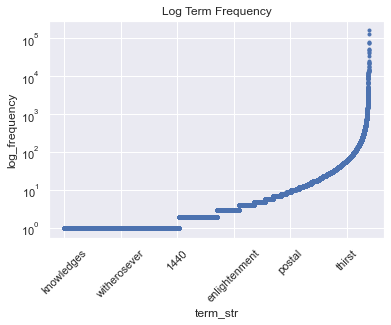

In [30]:
VOCAB.n.sort_values().plot(ylabel = "log_frequency", logy=True, style = '.', rot = 45, title = "Log Term Frequency");


### **Add Term Rank $r$ to `VOCAB`**

In [31]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending = False).reset_index()
    VOCAB.index.name = 'term_rank'
    VOCAB = VOCAB.reset_index()
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1
    VOCAB = VOCAB.set_index('term_str')

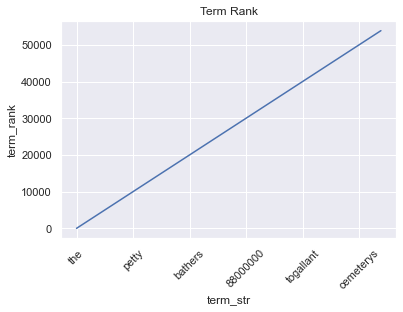

In [32]:
VOCAB.term_rank.plot(ylabel = "term_rank", logx = False, rot = 45, title = "Term Rank");

In [33]:
VOCAB.head()

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,,
the,1,161902,3,0.054506,4.197452,DT,20,"{'RP', 'NNS', 'FW', 'VBG', 'RB', 'JJ', 'PRP', ...",1,the,the,the
and,2,128130,3,0.043136,4.534964,CC,17,"{'RP', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'POS'...",1,and,and,and
of,3,82827,2,0.027884,5.164400,IN,17,"{'PDT', 'RP', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP'...",1,of,of,of
a,4,76650,1,0.025805,5.276215,DT,19,"{'RP', 'NNS', 'FW', 'RB', 'JJ', 'NNPS', 'PRP',...",1,a,a,a
to,5,75666,2,0.025474,5.294856,TO,18,"{'PDT', 'RP', 'VBZ', 'JJR', 'NNS', 'TO', 'VB',...",1,to,to,to


### **Alternate Rank: words that appear the same number of times given the same rank**

In [34]:
# times each num of times a term appears (e.g., 18273 terms appear 1 time)
# sort in descending order
# reset indices and rename cols --> nn: times each num of times a term appears

new_rank = VOCAB.n.value_counts()\
                   .sort_index(ascending = False).reset_index().reset_index()\
                   .rename(columns={'level_0': 'term_rank2', 'index': 'n', 'n': 'nn'})\
                    .set_index('n')

VOCAB['term_rank2'] = VOCAB.n.map(new_rank.term_rank2) + 1

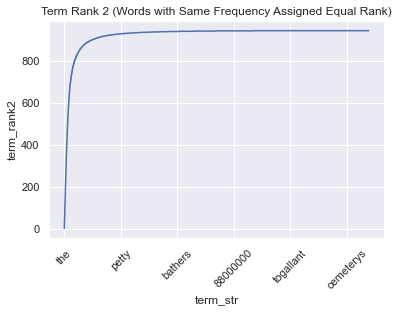

In [35]:
VOCAB.term_rank2.plot(ylabel = 'term_rank2', logx = False, rot = 45, title = "Term Rank 2 (Words with Same Frequency Assigned Equal Rank)");

### **Compute Zipf's $k$ using `term_rank` and `term_rank2`**

* **Equation**: $k = fr$

In [36]:
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank
VOCAB['zipf_k2'] = VOCAB.n * VOCAB.term_rank2

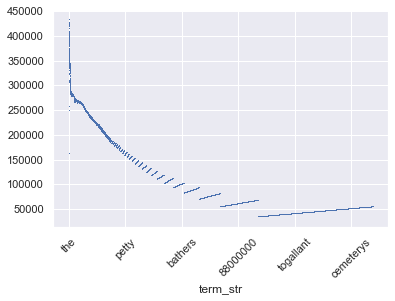

In [37]:
VOCAB.zipf_k.plot(style = ',', rot = 45);

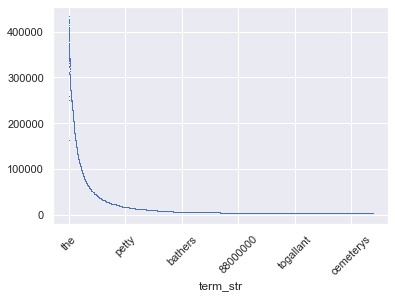

In [38]:
VOCAB.zipf_k2.plot(style = ',', rot = 45);

### **Rank vs. N (frequency `n`)**

As rank (`term_rank2`) increases, frequnecy (`n`) decreases

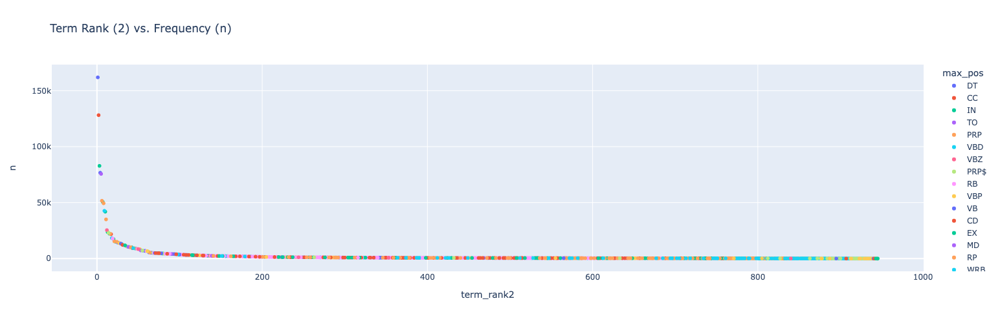

In [39]:
# scatter plot of term_rank2 vs. n color coded by part of speech (POS)

px.scatter(VOCAB.reset_index(),
           x = 'term_rank2', y = 'n',
           title = 'Term Rank (2) vs. Frequency (n)',
           log_y = False, log_x = False,
           hover_name = 'term_str',
           color = 'max_pos',
           height = 500, width = 800)

### **BOW (Bag of Words) and TFIDF (Term Frequency - Inverse Document Frequency)**

In [40]:
BOW = create_bow(CORPUS, CHAPS)

In [41]:
DTCM, TFIDF, BOW, DFIDF, VOCAB = get_tfidf(BOW, VOCAB, tf_method = 'max', idf_method = 'standard')

In [42]:
VOCAB

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster,term_rank2,zipf_k,zipf_k2,tfidf_mean_chap_max,tfidf_max_chap_max,df,idf,dfidf
term_str,,,,,,,,,,,,,,,,,,,,
the,1,161902,3,5.450559e-02,4.197452,DT,20,"{'RP', 'NNS', 'FW', 'VBG', 'RB', 'JJ', 'PRP', ...",1,the,the,the,1,161902,161902,0.002433,0.002606,1106.0,0.002606,2.882784
and,2,128130,3,4.313598e-02,4.534964,CC,17,"{'RP', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'POS'...",1,and,and,and,2,256260,256260,0.003973,0.005218,1104.0,0.005218,5.760351
of,3,82827,2,2.788437e-02,5.164400,IN,17,"{'PDT', 'RP', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP'...",1,of,of,of,3,248481,248481,0.001907,0.003912,1105.0,0.003912,4.322221
a,4,76650,1,2.580483e-02,5.276215,DT,19,"{'RP', 'NNS', 'FW', 'RB', 'JJ', 'NNPS', 'PRP',...",1,a,a,a,4,306600,306600,0.003668,0.007834,1102.0,0.007834,8.632691
to,5,75666,2,2.547356e-02,5.294856,TO,18,"{'PDT', 'RP', 'VBZ', 'JJR', 'NNS', 'TO', 'VB',...",1,to,to,to,5,378330,378330,0.001778,0.003912,1105.0,0.003912,4.322221
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ouvre,53850,1,5,3.366579e-07,21.502213,NN,1,{'NN'},0,ouvr,ouvr,ouvr,945,53850,945,0.041792,0.041792,1.0,10.113742,10.113742
outworks,53851,1,8,3.366579e-07,21.502213,NNS,1,{'NNS'},0,outwork,outwork,outwork,945,53851,945,0.066103,0.066103,1.0,10.113742,10.113742
outwitted,53852,1,9,3.366579e-07,21.502213,JJ,1,{'JJ'},0,outwit,outwit,outwit,945,53852,945,0.056187,0.056187,1.0,10.113742,10.113742


### **Document-Term Count Matrix `DTCM`**

In [43]:
DTCM

term_str           0   00   01   02   03   04   05   06   07   08  ...  étant  \
book_id chap_id                                                    ...          
70      1        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        2        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        3        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        4        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        5        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
...              ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...    ...   
62739   2        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        3        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        4        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        5        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        6        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   

term_str         éternumens  étouffante  étranger  évitant  êtes  être  \
book_id chap_id                                                          
70      1               0.0         0.0       0.0      0.0   0.0   0.0   
        2               0.0         0.0       0.0      0.0   0.0   0.0   
        3               0.0         0.0       0.0      0.0   0.0   0.0   
        4               0.0         0.0       0.0      0.0   0.0   0.0   
        5               0.0         0.0       0.0      0.0   0.0   0.0   
...                     ...         ...       ...      ...   ...   ...   
62739   2               0.0         0.0       0.0      0.0   0.0   0.0   
        3               0.0         0.0       0.0      0.0   0.0   0.0   
        4               0.0         0.0       0.0      0.0   0.0   0.0   
        5               0.0         0.0       0.0      0.0   0.0   0.0   
        6               0.0         0.0       0.0      0.0   0.0   0.0   

term_str         öffnen  über  übergeschlagen  
book_id chap_id                                
70      1           0.0   0.0             0.0  
        2           0.0   0.0             0.0  
        3           0.0   0.0             0.0  
        4           0.0   0.0             0.0  
        5           0.0   0.0             0.0  
...                 ...   ...             ...  
62739   2           0.0   0.0             0.0  
        3           0.0   0.0             0.0  
        4           0.0   0.0             0.0  
        5           0.0   0.0             0.0  
        6           0.0   0.0             0.0  

[1108 rows x 53852 columns]

### **Reduce number of features in `VOCAB`, TFIDF matrix to the 1000 most significant terms**
* #### DFIDF: the significance measure
* #### Only include terms whose maximum part-of-speech belongs to this set:
    * #### NN NNS VB VBD VBG VBN VBP VBZ JJ JJR JJS RB RBR RBS.
    * #### Note, these are all open categories, excluding proper nouns.

In [44]:
# open POS categories
open_cats = ['NN', 'NNS', 'VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ', 'JJ',
             'JJR', 'JJS', 'RB', 'RBR', 'RBS']

# reduce VOCAB to significant terms --> filter POS, sort , take top 1000
SIGS = VOCAB.loc[VOCAB.max_pos.isin(open_cats)] \
            .sort_values('dfidf', ascending = False) \
            .iloc[:1000,]

In [45]:
SIGS

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster,term_rank2,zipf_k,zipf_k2,tfidf_mean_chap_max,tfidf_max_chap_max,df,idf,dfidf
term_str,,,,,,,,,,,,,,,,,,,,
saying,401,705,6,0.000237,12.040734,VBG,12,"{'VBG', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'IN'...",0,say,say,say,374,282705,263670,0.017010,0.096088,408.0,1.441317,588.057264
seem,378,752,4,0.000253,11.947624,VB,7,"{'VBZ', 'VB', 'NNP', 'JJ', 'VBP', 'CC', 'NN'}",0,seem,seem,seem,354,284256,266208,0.017707,0.222286,407.0,1.444857,588.056873
indeed,373,758,6,0.000255,11.936159,NN,12,"{'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'POS', 'IN'...",0,inde,inde,indee,351,282734,266058,0.018638,0.220656,410.0,1.434262,588.047447
couldnt,246,1219,7,0.000410,11.250731,VBP,11,"{'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'RB', 'MD',...",0,couldnt,couldnt,couldnt,241,299874,293779,0.029341,0.181496,405.0,1.451964,588.045448
door,319,885,4,0.000298,11.712680,NN,8,"{'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'FW', 'JJ',...",0,door,door,door,306,282315,270810,0.021854,0.290393,405.0,1.451964,588.045448
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
record,1249,215,6,0.000072,13.754020,NN,6,"{'VBZ', 'VB', 'NNP', 'VBP', 'JJ', 'NN'}",0,record,record,record,731,268535,157165,0.027074,0.269454,142.0,2.963995,420.887297
watched,1423,188,7,0.000063,13.947624,VBD,8,"{'VB', 'VBD', 'IN', 'VBN', 'JJR', 'VBP', 'JJ',...",0,watch,watch,watch,758,267524,142504,0.025564,0.158080,142.0,2.963995,420.887297
laws,1231,219,4,0.000074,13.727426,NNS,8,"{'VBZ', 'NNS', 'JJS', 'VB', 'NNP', 'IN', 'JJ',...",0,law,law,law,727,269589,159213,0.033740,0.635142,142.0,2.963995,420.887297


In [139]:
SIGS.head(10).index.values

array(['saying', 'seem', 'indeed', 'couldnt', 'door', 'taken', 'deal',
       'fifty', 'getting', 'perhaps'], dtype=object)

### **"Collapse" the TFIDF matrix so that it contains mean TFIDF of each term by book.**

* #### **Result: matrix with book IDs as rows, significant terms as cols**

In [46]:
TFIDF

term_str           0   00   01   02   03   04   05   06   07   08  ...  étant  \
book_id chap_id                                                    ...          
70      1        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        2        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        3        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        4        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        5        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
...              ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...    ...   
62739   2        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        3        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        4        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        5        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   
        6        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...    0.0   

term_str         éternumens  étouffante  étranger  évitant  êtes  être  \
book_id chap_id                                                          
70      1               0.0         0.0       0.0      0.0   0.0   0.0   
        2               0.0         0.0       0.0      0.0   0.0   0.0   
        3               0.0         0.0       0.0      0.0   0.0   0.0   
        4               0.0         0.0       0.0      0.0   0.0   0.0   
        5               0.0         0.0       0.0      0.0   0.0   0.0   
...                     ...         ...       ...      ...   ...   ...   
62739   2               0.0         0.0       0.0      0.0   0.0   0.0   
        3               0.0         0.0       0.0      0.0   0.0   0.0   
        4               0.0         0.0       0.0      0.0   0.0   0.0   
        5               0.0         0.0       0.0      0.0   0.0   0.0   
        6               0.0         0.0       0.0      0.0   0.0   0.0   

term_str         öffnen  über  übergeschlagen  
book_id chap_id                                
70      1           0.0   0.0             0.0  
        2           0.0   0.0             0.0  
        3           0.0   0.0             0.0  
        4           0.0   0.0             0.0  
        5           0.0   0.0             0.0  
...                 ...   ...             ...  
62739   2           0.0   0.0             0.0  
        3           0.0   0.0             0.0  
        4           0.0   0.0             0.0  
        5           0.0   0.0             0.0  
        6           0.0   0.0             0.0  

[1108 rows x 53852 columns]

In [47]:
TFIDF_sigs = TFIDF[SIGS.index]

In [48]:
TFIDF_sigs

term_str           saying      seem    indeed   couldnt      door     taken  \
book_id chap_id                                                               
70      1        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        2        0.005272  0.005285  0.005246  0.010622  0.001062  0.004187   
        3        0.006831  0.000000  0.000000  0.006881  0.055051  0.000000   
        4        0.005859  0.000000  0.005830  0.005902  0.000000  0.000000   
        5        0.008429  0.012674  0.004194  0.012737  0.004246  0.004183   
...                   ...       ...       ...       ...       ...       ...   
62739   2        0.016015  0.008027  0.003984  0.004033  0.000000  0.003974   
        3        0.045041  0.045152  0.000000  0.000000  0.000000  0.000000   
        4        0.005093  0.005106  0.005068  0.010261  0.005131  0.000000   
        5        0.000000  0.000000  0.000000  0.000000  0.000000  0.013626   
        6        0.000000  0.000000  0.000000  0.000000  0.000000  0.043356   

term_str             deal     fifty   getting   perhaps  ...     shame  \
book_id chap_id                                          ...             
70      1        0.000000  0.000000  0.000000  0.000000  ...  0.000000   
        2        0.002093  0.004187  0.002130  0.014907  ...  0.013009   
        3        0.000000  0.006781  0.006898  0.000000  ...  0.000000   
        4        0.011632  0.017448  0.000000  0.011834  ...  0.000000   
        5        0.004183  0.012550  0.008512  0.008512  ...  0.000000   
...                   ...       ...       ...       ...  ...       ...   
62739   2        0.003974  0.000000  0.000000  0.000000  ...  0.024700   
        3        0.000000  0.044711  0.000000  0.000000  ...  0.000000   
        4        0.000000  0.005056  0.005143  0.000000  ...  0.010473   
        5        0.013626  0.000000  0.000000  0.000000  ...  0.000000   
        6        0.000000  0.000000  0.000000  0.000000  ...  0.000000   

term_str             dawn  privilege     loved      busy    record   watched  \
book_id chap_id                                                                
70      1        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        2        0.000000   0.002168  0.002168  0.002168  0.006505  0.006505   
        3        0.000000   0.000000  0.042142  0.000000  0.000000  0.000000   
        4        0.012049   0.024098  0.000000  0.000000  0.000000  0.000000   
        5        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
...                   ...        ...       ...       ...       ...       ...   
62739   2        0.000000   0.000000  0.000000  0.008233  0.024700  0.000000   
        3        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        4        0.000000   0.000000  0.000000  0.010473  0.010473  0.000000   
        5        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        6        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   

term_str             laws  information  questions  
book_id chap_id                                    
70      1        0.000000          0.0   0.000000  
        2        0.006505          0.0   0.002168  
        3        0.000000          0.0   0.000000  
        4        0.000000          0.0   0.012049  
        5        0.000000          0.0   0.000000  
...                   ...          ...        ...  
62739   2        0.000000          0.0   0.000000  
        3        0.000000          0.0   0.000000  
        4        0.000000          0.0   0.000000  
        5        0.000000          0.0   0.000000  
        6        0.000000          0.0   0.000000  

[1108 rows x 1000 columns]

In [49]:
print('max term TFIDF value:', max(TFIDF_sigs.sum(axis=0)))

print('max TFIDF term:', TFIDF_sigs.sum(axis = 0).idxmax())

max term TFIDF value: 20.442455786925322
max TFIDF term: dont


In [50]:
print('Max total TFIDF value by book and chapter:', max(TFIDF_sigs.sum(axis=1)))

print('(Book_id, chap_id) with max total TFIDF: ', TFIDF_sigs.sum(axis = 1).idxmax())

print('Title of book with max total TFIDF:', LIB.loc[TFIDF_sigs.sum(axis = 1).idxmax()[0]].title.title())

Max total TFIDF value by book and chapter: 10.103244296859762
(Book_id, chap_id) with max total TFIDF:  (102, 4)
Title of book with max total TFIDF: The Tragedy Of Puddnhead Wilson


### **Rank and TFIDF Mean**

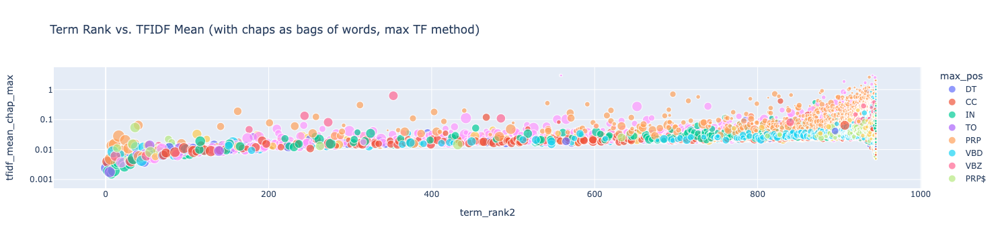

In [51]:
px.scatter(VOCAB.reset_index(),
           x = 'term_rank2', y = 'tfidf_mean_chap_max',
           title = 'Term Rank vs. TFIDF Mean (with chaps as bags of words, max TF method)',
           color = 'max_pos', size = 'n_pos',
           hover_name = 'term_str', hover_data = ['n', 'i'],
           log_y = True, log_x = False)

### **Rank and DFIDF**

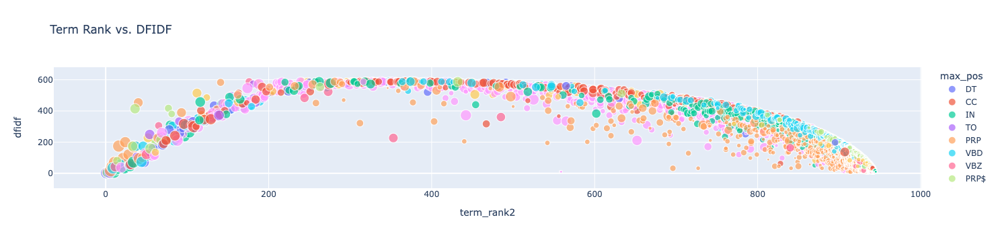

In [52]:
px.scatter(VOCAB.reset_index(),
           x = 'term_rank2', y = 'dfidf',
           title = 'Term Rank vs. DFIDF',
           color = 'max_pos', size = 'n_pos',
           hover_name = 'term_str', hover_data = ['n', 'i'])

## **M06: Similarity and Clustering**

### **Collapse Bags (to use for clustering)**

* #### Note: not the same as computing TFIDF with larger bags

#### **Mean TFIDF for each book for all terms**

In [53]:
# group by book_id (BOOKS = OHCO[:1])
mean_TFIDF = TFIDF.groupby(BOOKS).mean()

mean_TFIDF

term_str,0,00,01,02,03,04,05,06,07,08,...,étant,éternumens,étouffante,étranger,évitant,êtes,être,öffnen,über,übergeschlagen
book_id,,,,,,,,,,,,,,,,,,,,,
70,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
74,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
76,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
86,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
91,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
93,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
102,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
119,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
142,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


#### **Mean TFIDF for all book for 1000 most significant terms only**

In [54]:
mean_TFIDF_sigs = TFIDF_sigs.groupby(BOOKS).mean()

mean_TFIDF_sigs

term_str,saying,seem,indeed,couldnt,door,taken,deal,fifty,getting,perhaps,...,shame,dawn,privilege,loved,busy,record,watched,laws,information,questions
book_id,,,,,,,,,,,,,,,,,,,,,
70,0.002214,0.005691,0.003876,0.005907,0.007669,0.005358,0.004758,0.009586,0.001288,0.005993,...,0.003571,0.001598,0.004269,0.003706,0.003537,0.000905,0.000383,0.002605,0.004543,0.005220
74,0.006860,0.005358,0.005679,0.010177,0.018570,0.003364,0.001466,0.002715,0.010265,0.002536,...,0.003079,0.002429,0.001020,0.006155,0.003242,0.001439,0.010875,0.002685,0.000952,0.002359
76,0.011842,0.008150,0.000312,0.051429,0.017287,0.000202,0.003498,0.002909,0.011204,0.000130,...,0.001816,0.001550,0.000000,0.001259,0.000312,0.001902,0.005608,0.002546,0.000621,0.005413
86,0.004200,0.009052,0.008176,0.028338,0.009332,0.005638,0.007524,0.005537,0.006675,0.003103,...,0.003548,0.005953,0.000699,0.000719,0.002557,0.002697,0.004592,0.019162,0.002403,0.005275
91,0.009653,0.012530,0.000000,0.073216,0.001092,0.000000,0.005023,0.005192,0.009605,0.000757,...,0.001065,0.004166,0.000000,0.001416,0.004166,0.000000,0.005277,0.005399,0.000000,0.001163
93,0.005316,0.006406,0.000000,0.049434,0.016613,0.000000,0.005417,0.001492,0.018616,0.000000,...,0.000524,0.006596,0.000000,0.005538,0.001821,0.000000,0.009421,0.004995,0.000000,0.009122
102,0.014221,0.001967,0.006542,0.020268,0.018873,0.006466,0.004435,0.002955,0.006372,0.003764,...,0.007376,0.009475,0.001214,0.005499,0.001247,0.004911,0.007838,0.012873,0.000000,0.010592
119,0.004359,0.008560,0.005958,0.003688,0.006101,0.003824,0.006648,0.008816,0.004698,0.007719,...,0.000762,0.003765,0.001968,0.000807,0.002459,0.003095,0.005096,0.003474,0.004153,0.001234
142,0.007268,0.004428,0.005972,0.003653,0.004329,0.004804,0.003849,0.008807,0.005343,0.006197,...,0.003847,0.001328,0.005567,0.005362,0.003762,0.005743,0.001111,0.000177,0.002947,0.005733


### **`DOC` Table**

* #### Same as `LIB` table when books are docs

In [55]:
book_DOC = pd.DataFrame(index = mean_TFIDF.index)

In [56]:
book_DOC = book_DOC.join(LIB[['author', 'title']])

book_DOC['label'] = book_DOC.apply(lambda x: f"{x.author.split(',')[0]} {x.name}: {x.title}", 1)

In [57]:
book_DOC

,author,title,label
book_id,,,
70,twain,what is man,twain 70: what is man
74,twain,the adventures of tom sawyer,twain 74: the adventures of tom sawyer
76,twain,the adventures of huckleberry finn,twain 76: the adventures of huckleberry finn
86,twain,a connecticut yankee in king arthurs court,twain 86: a connecticut yankee in king arthurs...
91,twain,tom sawyer abroad,twain 91: tom sawyer abroad
93,twain,tom sawyer detective,twain 93: tom sawyer detective
102,twain,the tragedy of puddnhead wilson,twain 102: the tragedy of puddnhead wilson
119,twain,a tramp abroad,twain 119: a tramp abroad
142,twain,the 30000 bequest and other stories,twain 142: the 30000 bequest and other stories


### **Normalized Tables for Clustering**

In [58]:
# binary table
L0 = mean_TFIDF_sigs.astype('bool').astype('int')

# Manhattan distance (L1 norm): divide each value by sum down cols
L1 = mean_TFIDF_sigs.apply(lambda x: x / x.sum(), 1)

# Euclidean distance (L2 norm)
L2 = mean_TFIDF_sigs.apply(lambda x: x / norm(x), 1) # Euclidean

In [59]:
assert round(L1.sum(1).sum()) == len(mean_TFIDF_sigs)

In [60]:
assert round(((L2.T)**2).sum().sum()) == len(mean_TFIDF_sigs)

### **Create table of book pairs (doc pair table `PAIRS`)**

In [61]:
mean_TFIDF_sigs.T.corr().stack()

book_id  book_id
70       70         1.000000
         74         0.065653
         76        -0.006768
         86         0.079010
         91        -0.002018
                      ...   
62739    33077      0.158020
         60900     -0.028375
         61522      0.001523
         62636      0.089411
         62739      1.000000
Length: 2025, dtype: float64

In [62]:
# correlation between books --> stack and convert to df with col for  raw correlation vals
PAIRS = 1 - mean_TFIDF_sigs.T.corr().stack().to_frame('corr_raw')

# rename indices
PAIRS.index.names = ['doc_a', 'doc_b']

# remove identities (e.g., corr(105, 105) and reverse dupliciates (e.g., corr(105, 121) = corr(121, 105))
PAIRS = PAIRS.query("doc_a > doc_b")

In [63]:
PAIRS

corr_raw
doc_a doc_b          
74    70     0.934347
76    70     1.006768
      74     0.500537
86    70     0.920990
      74     0.857285
...               ...
62739 19987  0.915541
      33077  0.841980
      60900  1.028375
      61522  0.998477
      62636  0.910589

[990 rows x 1 columns]

#### **Compute distance measures between all pairs of books using `pdist()`**

In [64]:
combos  = [
    (mean_TFIDF_sigs, 'cityblock', 'cityblock–raw'),
    (mean_TFIDF_sigs, 'euclidean', 'euclidean–raw'),
    (L2, 'euclidean', 'euclidean–l2'),    
    (mean_TFIDF_sigs, 'cosine', 'cosine–raw'),
    (L1, 'cityblock', 'cityblock–l1'),
    (L0, 'jaccard', 'jaccard–l0'),
    (L0, 'jensenshannon', 'js–l0'),
    (L1, 'jensenshannon', 'js–l1'),
    (L2, 'jensenshannon', 'js–l2'),
]

In [65]:
for X, metric, label in combos:
    PAIRS[label] = pdist(X, metric)

#### **Compare Distributions**

In [66]:
PAIRS.head(20)

corr_raw  cityblock–raw  euclidean–raw  euclidean–l2  cosine–raw  \
doc_a doc_b                                                                     
74    70     0.934347       4.546088       0.234767      0.939812    0.441623   
76    70     1.006768       4.975003       0.297118      1.093061    0.597391   
      74     0.500537       3.477613       0.178243      0.844661    0.356726   
86    70     0.920990       4.889381       0.292809      1.114627    0.621196   
      74     0.857285       5.511088       0.338610      1.151917    0.663457   
      76     0.873024       4.661049       0.244347      0.926136    0.428864   
91    70     1.002018       3.006633       0.140112      0.758177    0.287416   
      74     0.504966       3.346067       0.161667      0.766304    0.293611   
      76     0.176894       3.242933       0.186845      0.881473    0.388497   
      86     0.851959       6.592539       0.435993      1.107597    0.613386   
93    70     1.028131       4.887719       0.249661      1.002306    0.502308   
      74     0.562528       4.077018       0.188483      0.923076    0.426035   
      76     0.168563       3.664222       0.168963      0.841515    0.354074   
      86     0.885217       3.639949       0.174221      0.860308    0.370065   
      91     0.261414       2.630389       0.129681      0.712435    0.253782   
102   70     0.958330       5.277857       0.308049      0.978975    0.479196   
      74     0.531515       5.342585       0.279884      1.101894    0.607085   
      76     0.559315       6.213281       0.375334      0.995281    0.495292   
      86     0.892180       3.245179       0.158915      0.843261    0.355545   
      91     0.586890       3.370931       0.159585      0.833132    0.347054   

             cityblock–l1  jaccard–l0     js–l0     js–l1     js–l2  
doc_a doc_b                                                          
74    70         0.810756    0.037000  0.114145  0.368884  0.368884  
76    70         0.996911    0.128000  0.216051  0.448822  0.448822  
      74         0.648449    0.008000  0.052759  0.299841  0.299841  
86    70         1.037877    0.233233  0.297915  0.466381  0.466381  
      74         1.127231    0.311000  0.350048  0.509520  0.509520  
      76         0.754032    0.043000  0.123192  0.348537  0.348537  
91    70         0.623418    0.006000  0.045661  0.283683  0.283683  
      74         0.635085    0.009000  0.055975  0.287828  0.287828  
      76         0.644574    0.007000  0.049337  0.297017  0.297017  
      86         1.009056    0.301603  0.343793  0.469018  0.469018  
93    70         0.993955    0.259519  0.315950  0.447095  0.447095  
      74         0.823772    0.052000  0.135704  0.371631  0.371631  
      76         0.723915    0.030030  0.102677  0.331382  0.331382  
      86         0.747925    0.053000  0.137028  0.342492  0.342492  
      91         0.567135    0.005000  0.041665  0.259342  0.259342  
102   70         0.912322    0.310241  0.349162  0.430125  0.430125  
      74         1.197783    0.582915  0.513600  0.552857  0.552857  
      76         0.985214    0.393180  0.400941  0.462958  0.462958  
      86         0.689906    0.006000  0.045661  0.313367  0.313367  
      91         0.687526    0.006000  0.045661  0.310325  0.310325

### **Hierarchical agglomerative cluster diagrams for the distance measures**

In [67]:
LIB['label'] = book_DOC['label']

In [140]:
def hca(sims, title="My Dendrogram", linkage_method='weighted', color_thresh=None, figsize=(15, 20)):
    
    # calculate linkage using given method   
    tree = sch.linkage(sims, method=linkage_method)
    
    # extract labels (title, year)
    labels = LIB.label.values
    
    # set color threshold
    if not color_thresh:
        color_thresh = pd.DataFrame(tree)[2].median()
    
    # plot dendrograms for each distance metric and linkage method
    plt.figure()
    fig, axes = plt.subplots(figsize=figsize)
    dendrogram = sch.dendrogram(tree, 
                                labels=labels, 
                                orientation="left", 
                                count_sort=True,
                                distance_sort=True,
                                above_threshold_color='.75',
                                color_threshold=color_thresh
                               )
    plt.tick_params(axis='both', which='major', labelsize=14)
    fig.suptitle(title, fontsize=20)

/var/folders/3n/4b11y5qn5cn20kztppfbsxq40000gn/T/ipykernel_24732/163819248.py:14: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<Figure size 432x288 with 0 Axes>

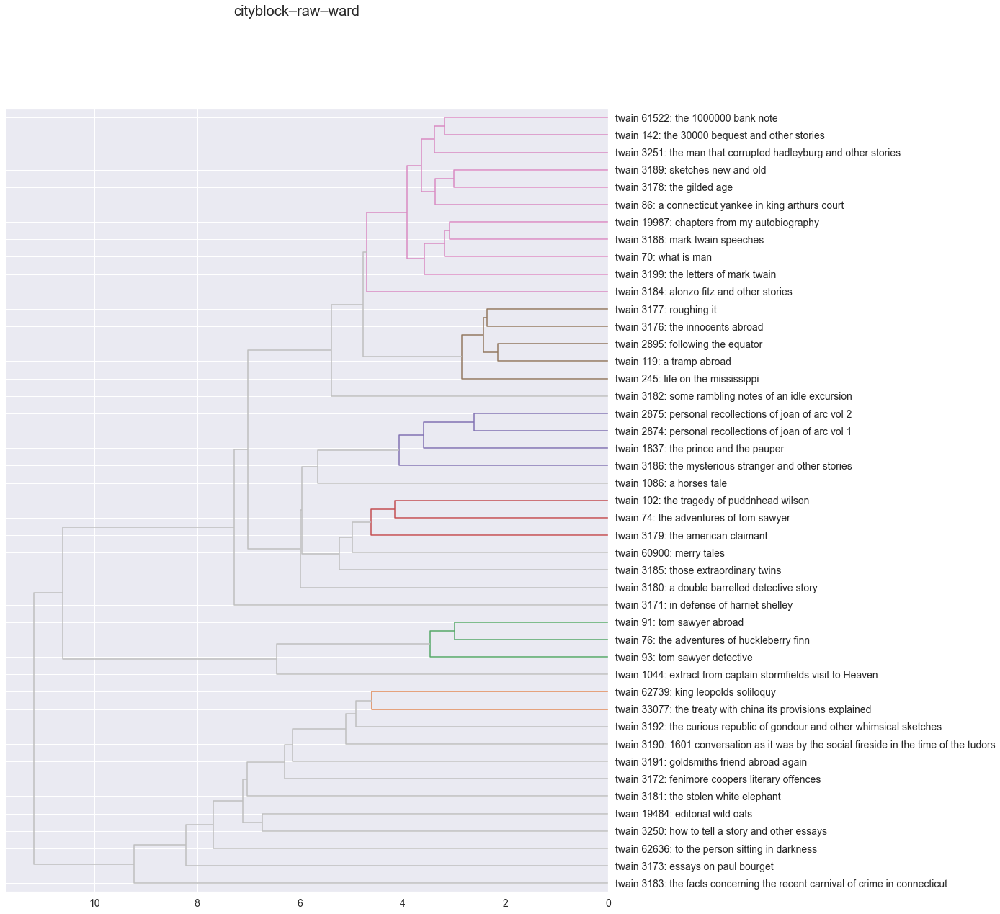

<Figure size 432x288 with 0 Axes>

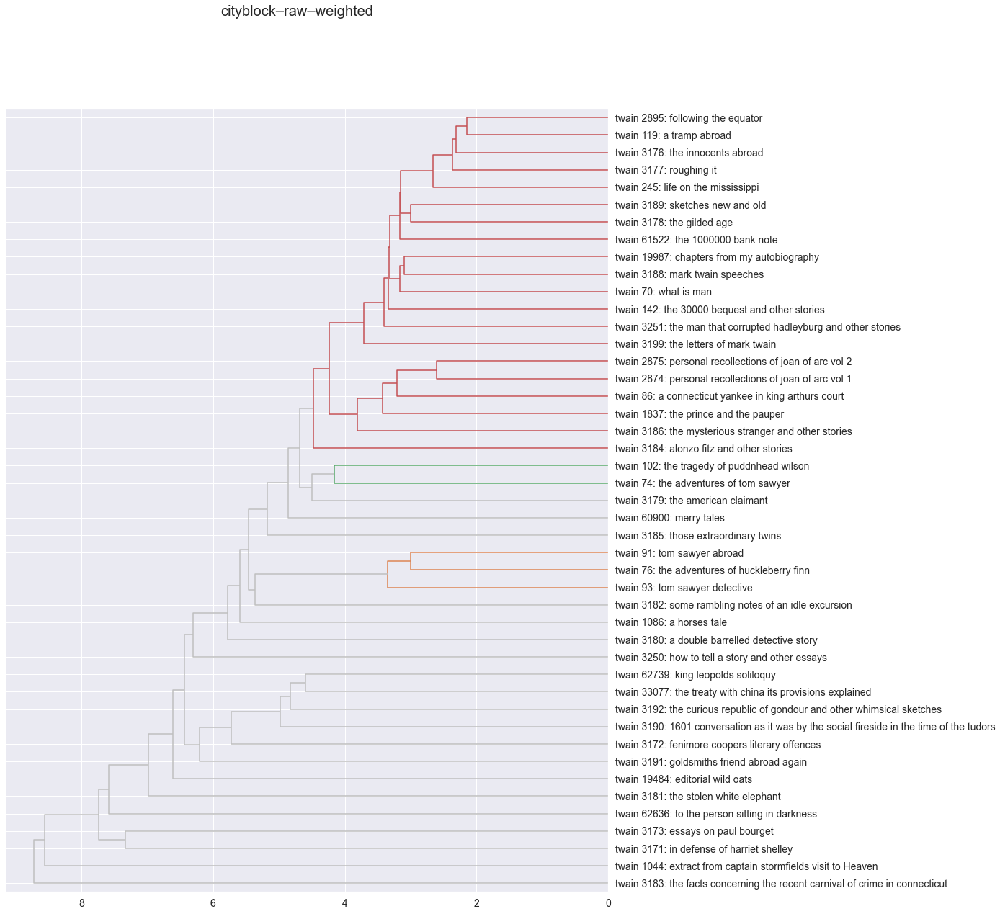

<Figure size 432x288 with 0 Axes>

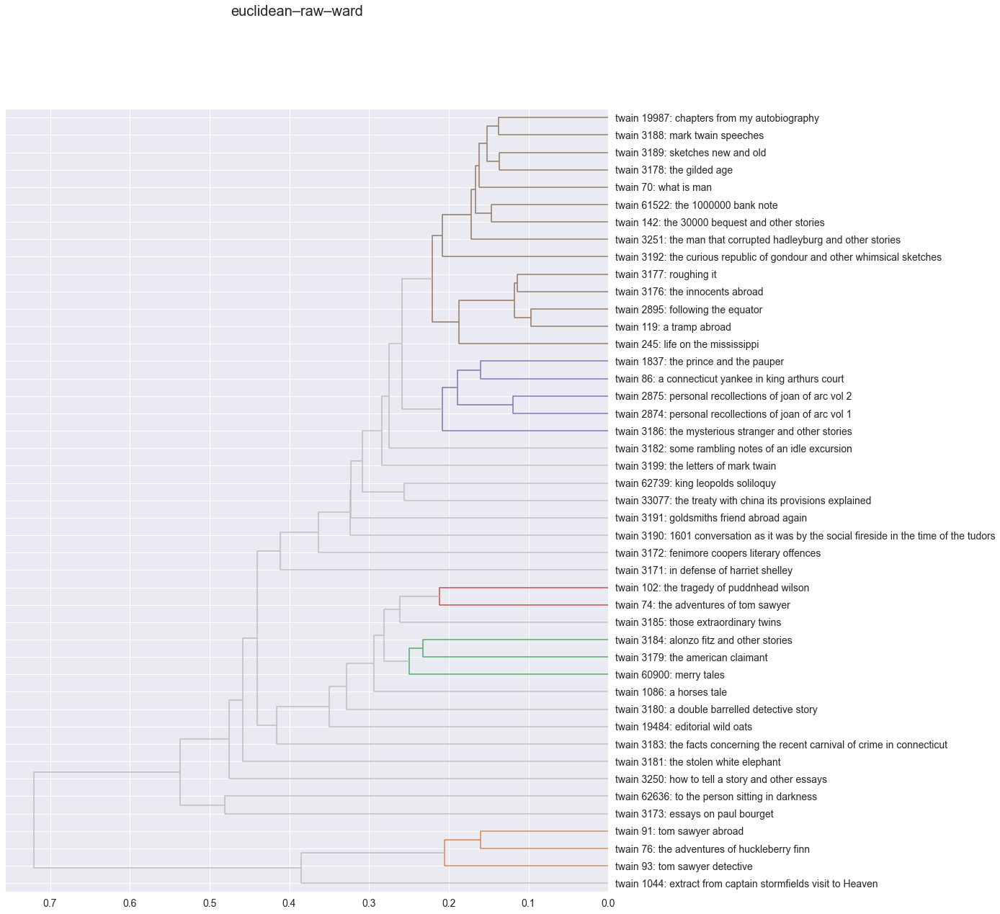

<Figure size 432x288 with 0 Axes>

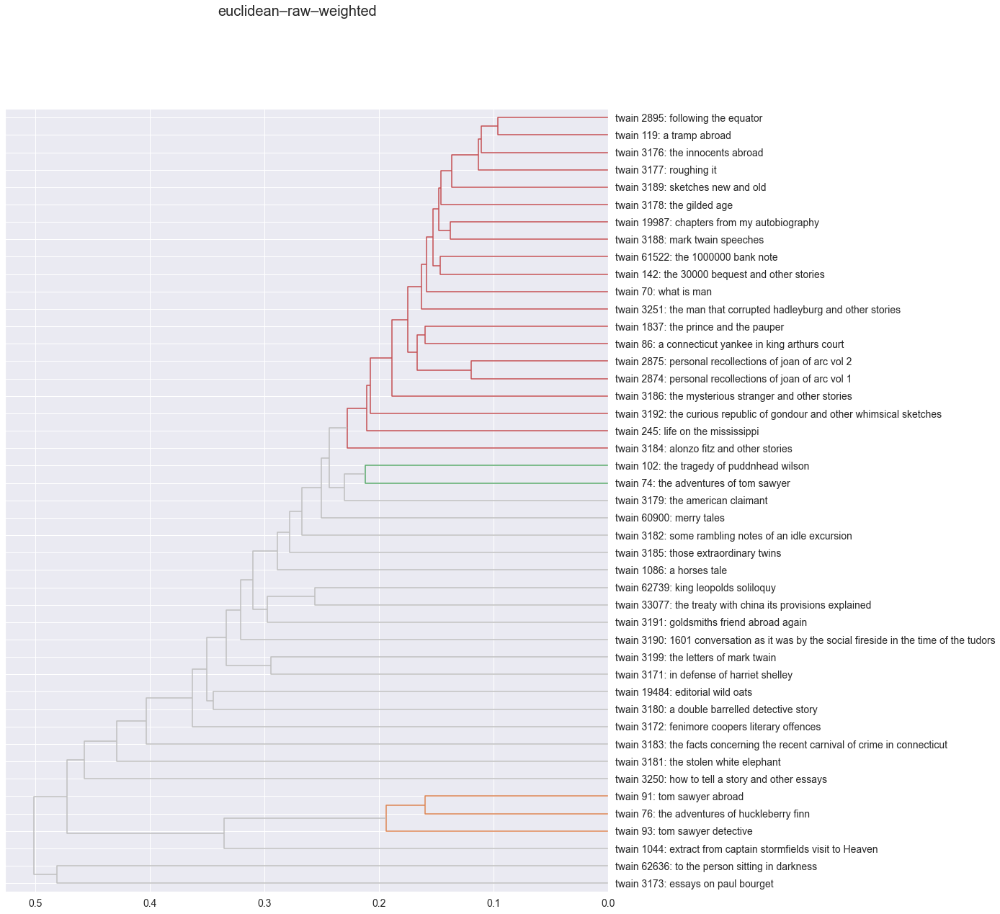

<Figure size 432x288 with 0 Axes>

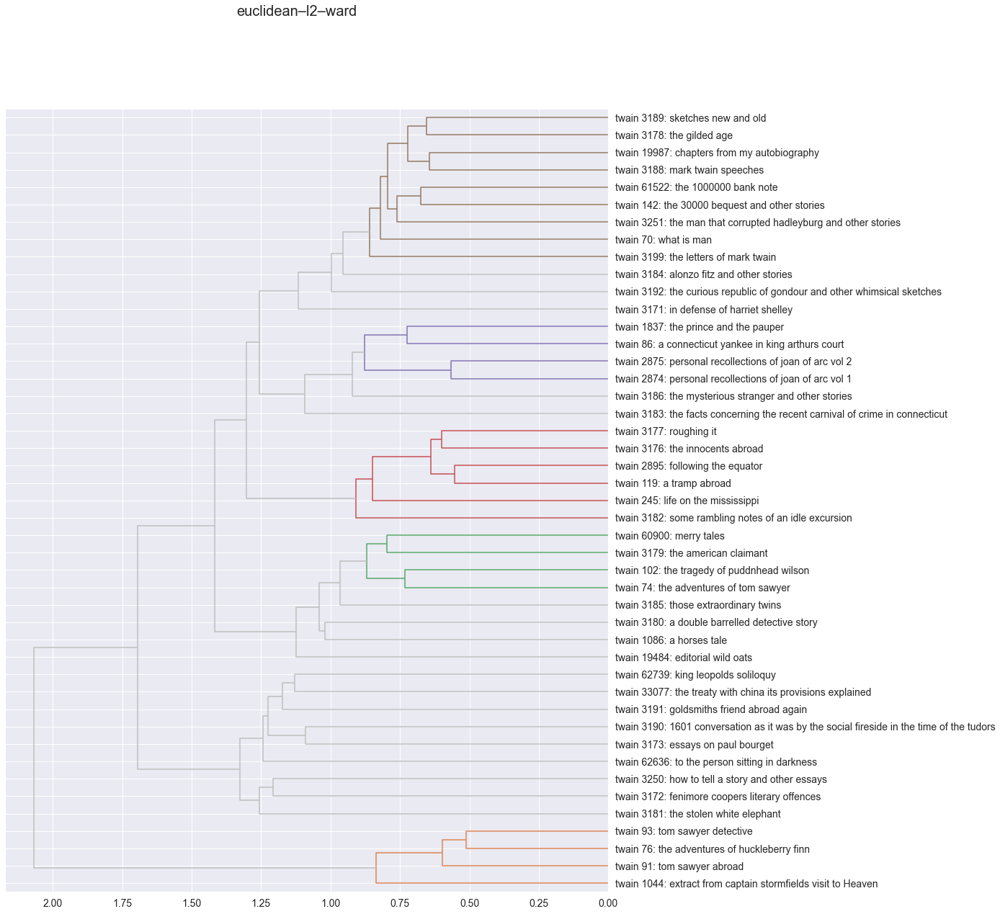

<Figure size 432x288 with 0 Axes>

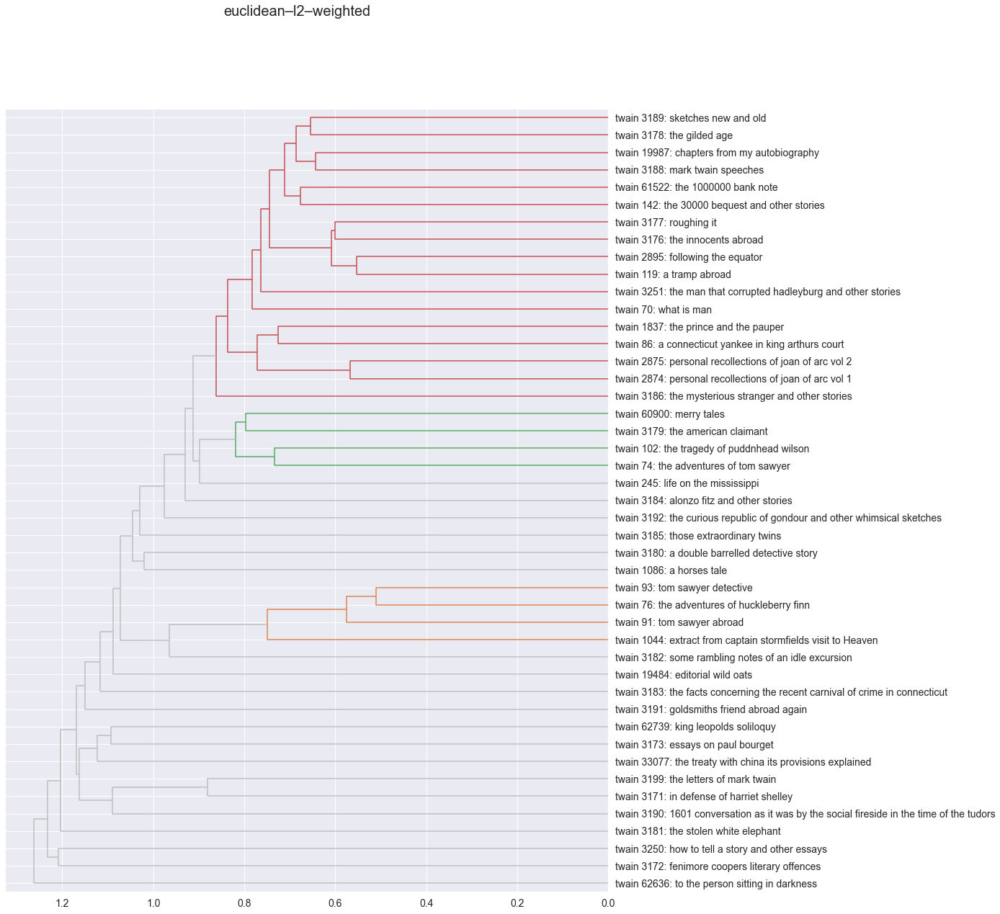

<Figure size 432x288 with 0 Axes>

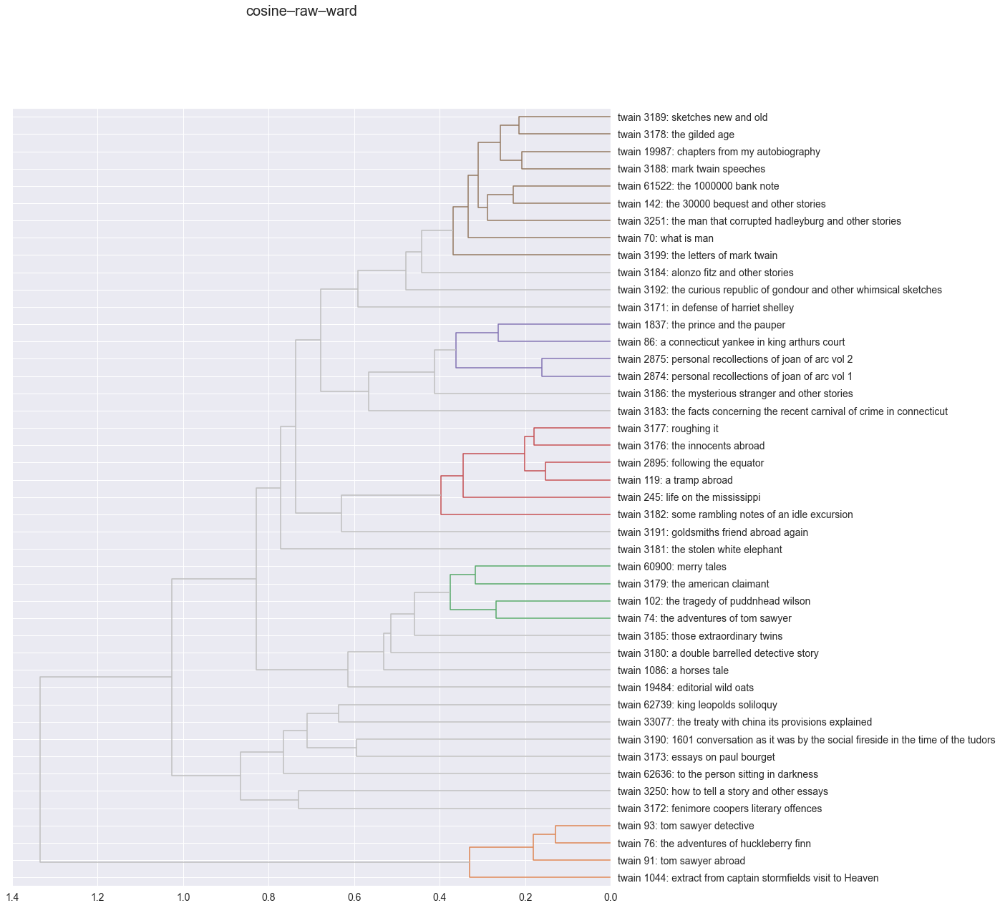

<Figure size 432x288 with 0 Axes>

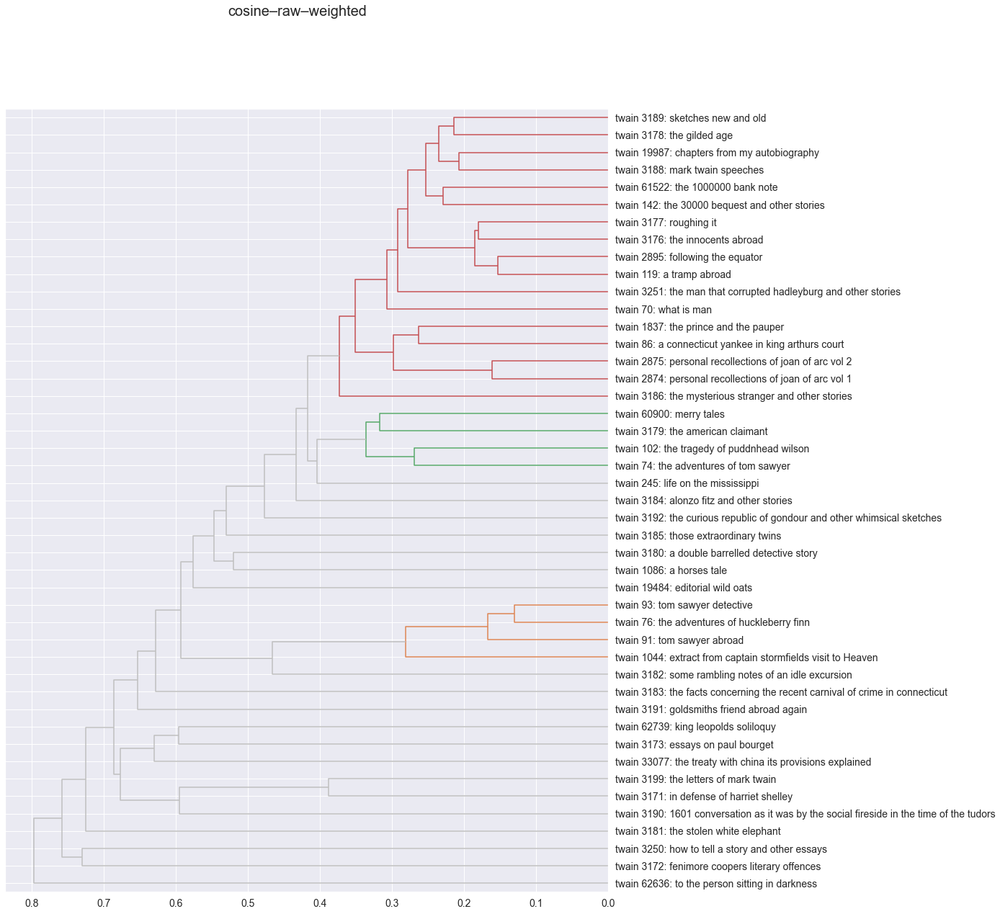

<Figure size 432x288 with 0 Axes>

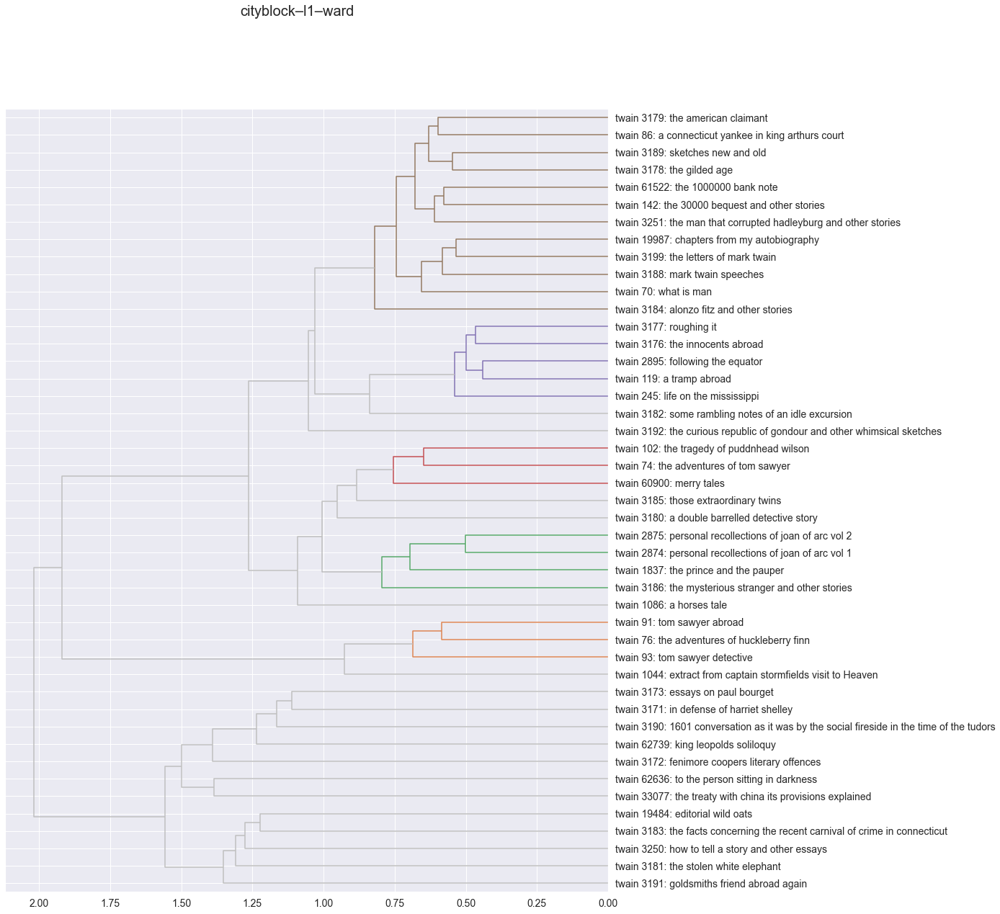

<Figure size 432x288 with 0 Axes>

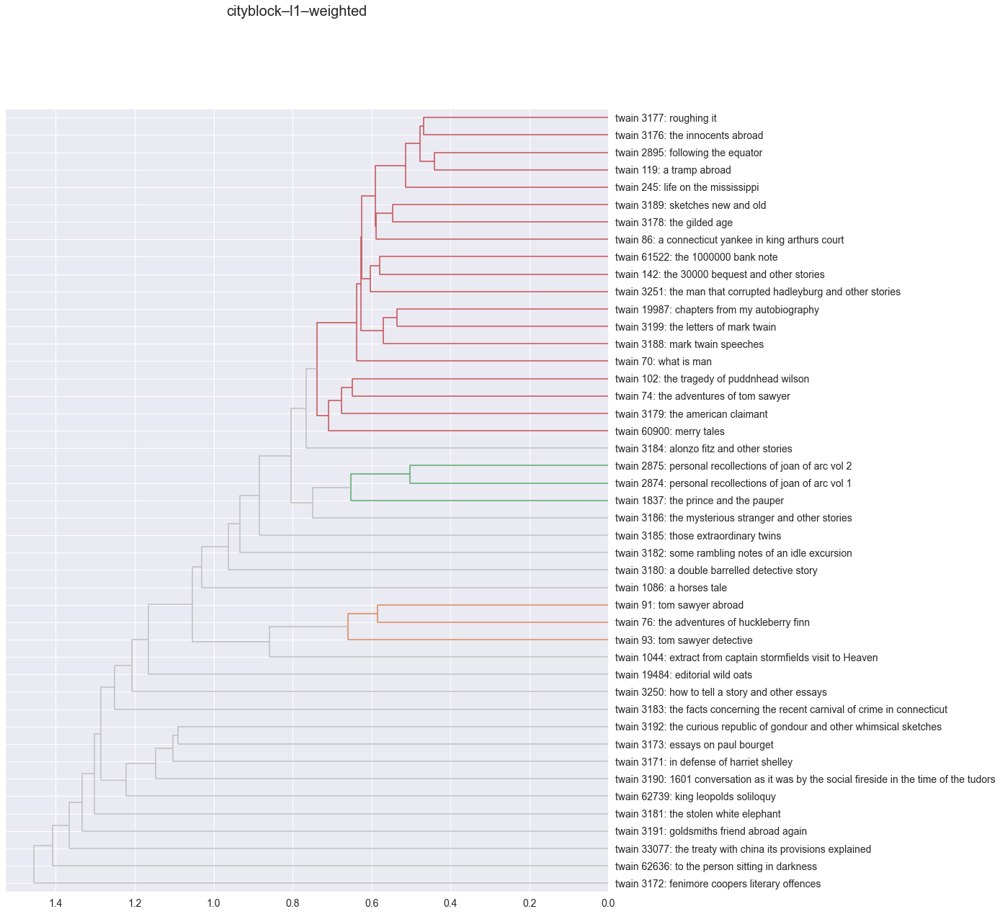

<Figure size 432x288 with 0 Axes>

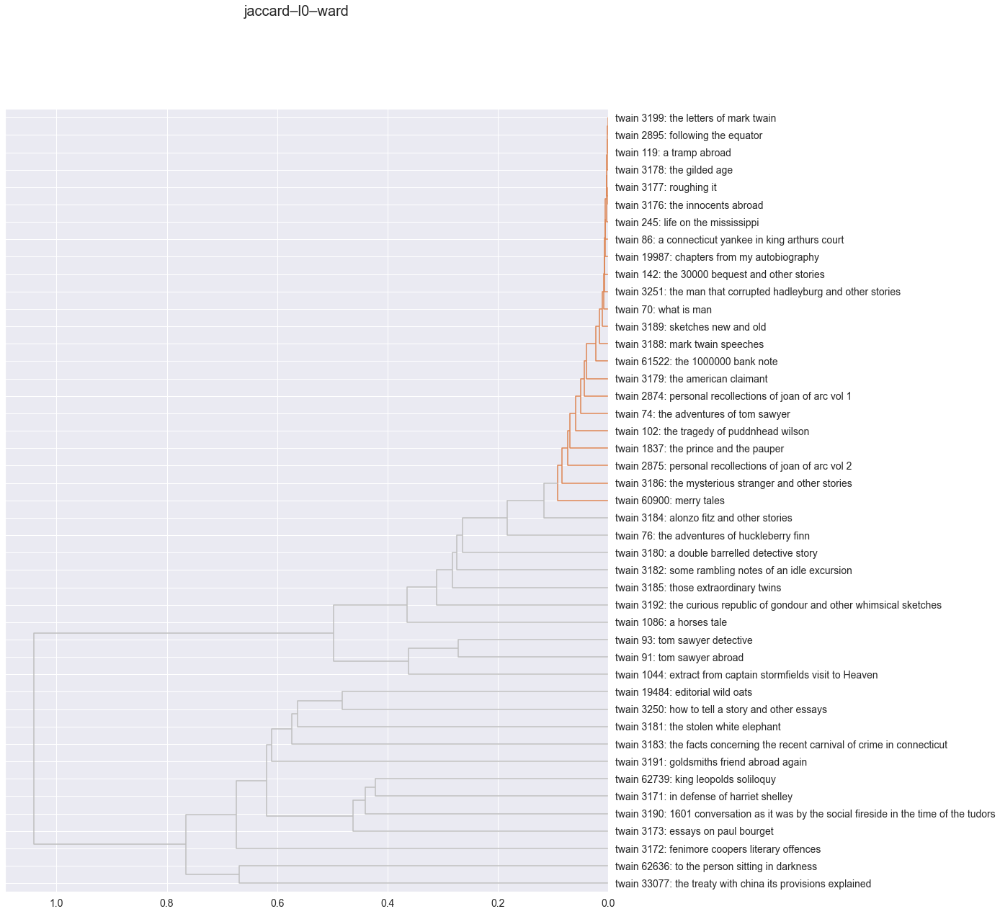

<Figure size 432x288 with 0 Axes>

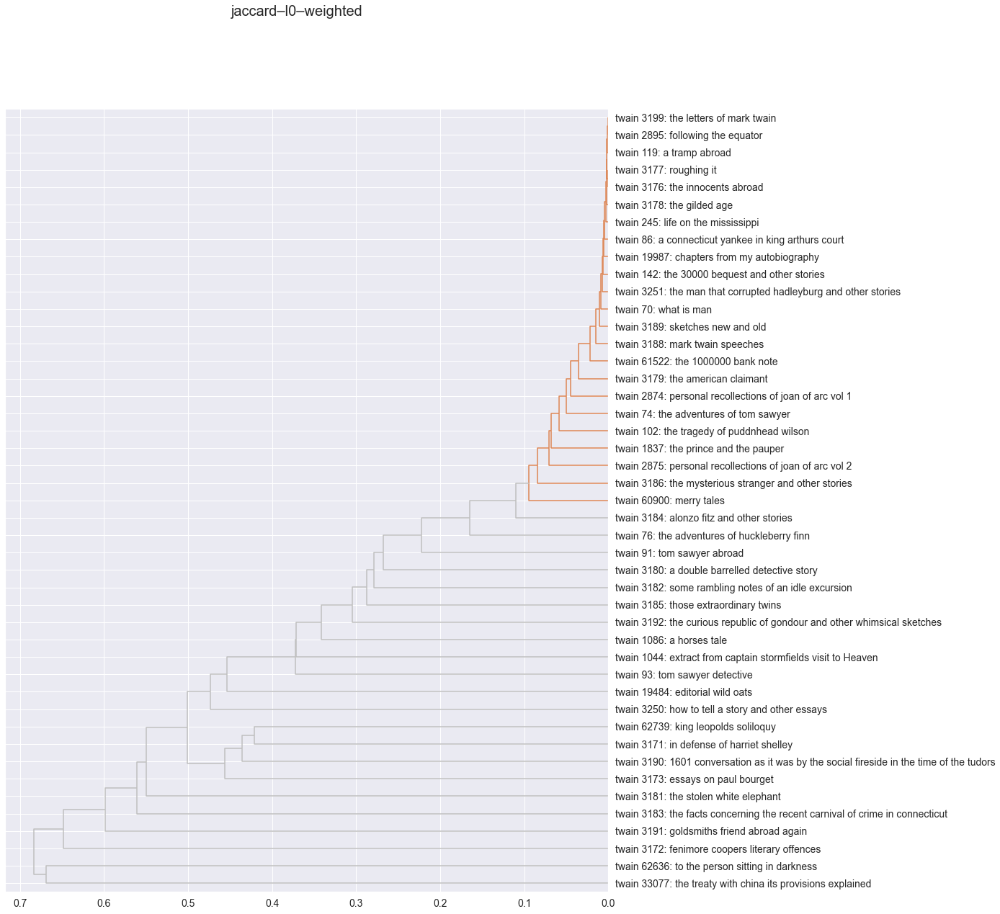

<Figure size 432x288 with 0 Axes>

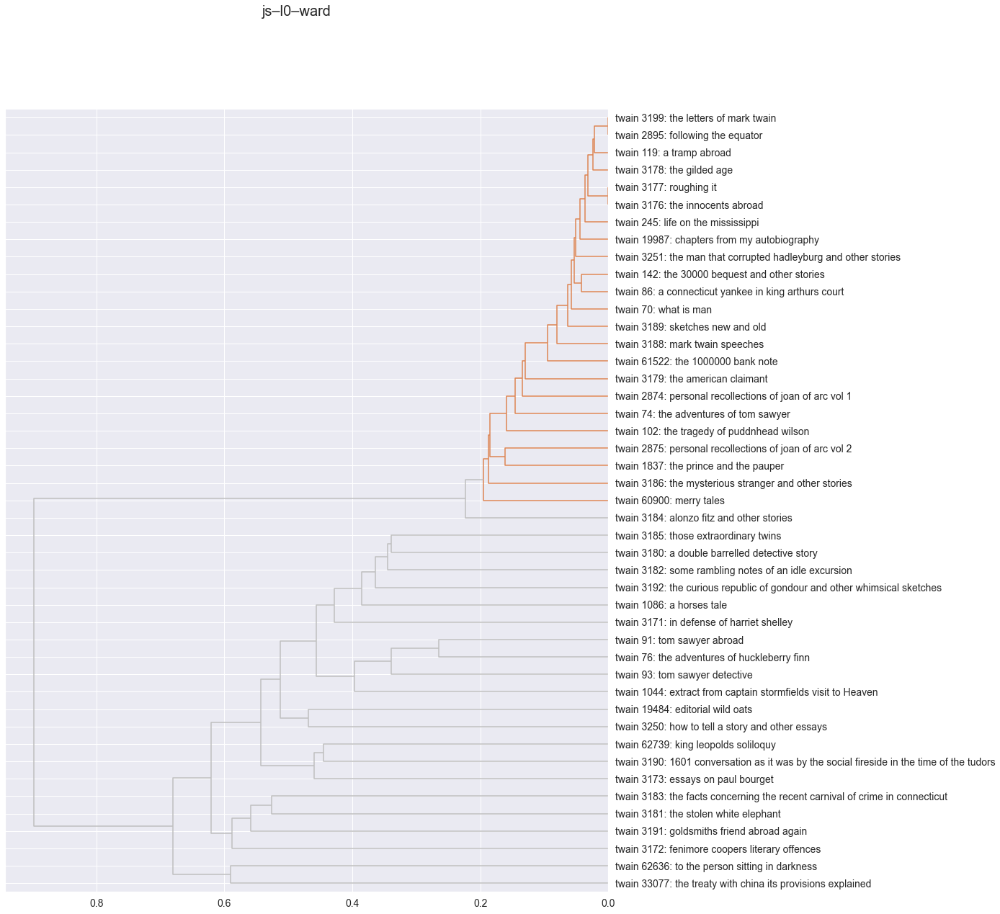

<Figure size 432x288 with 0 Axes>

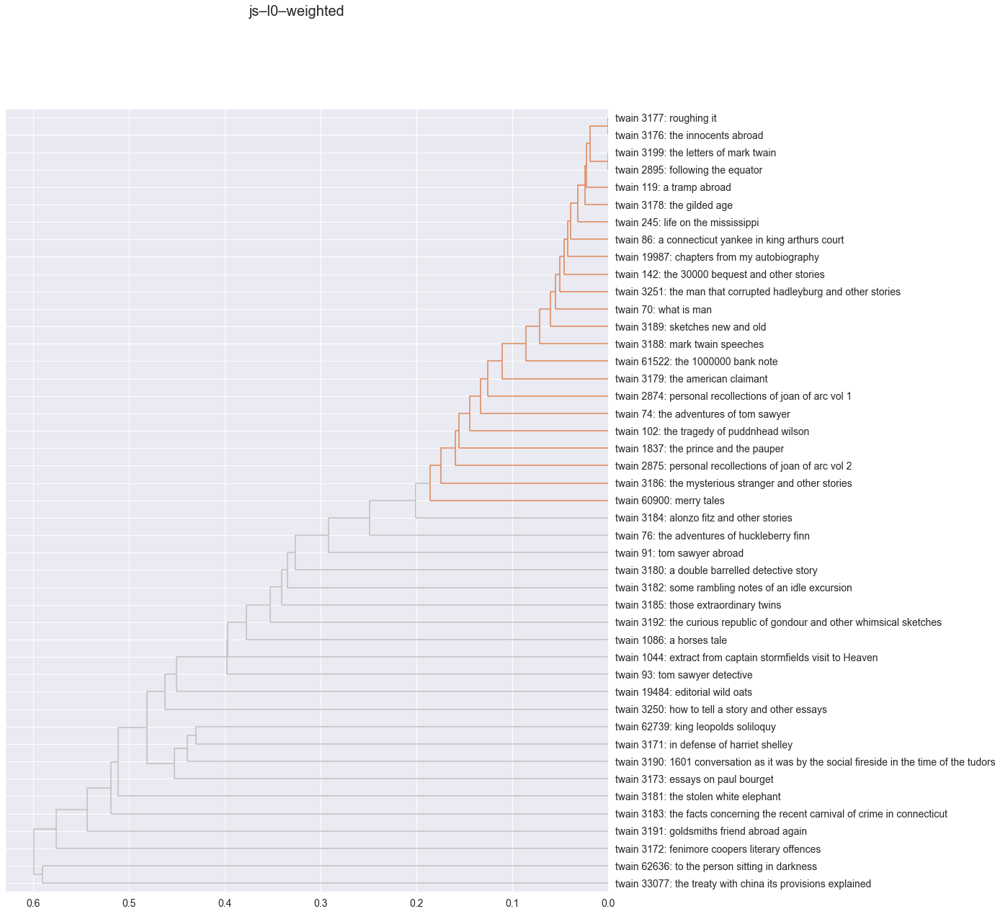

<Figure size 432x288 with 0 Axes>

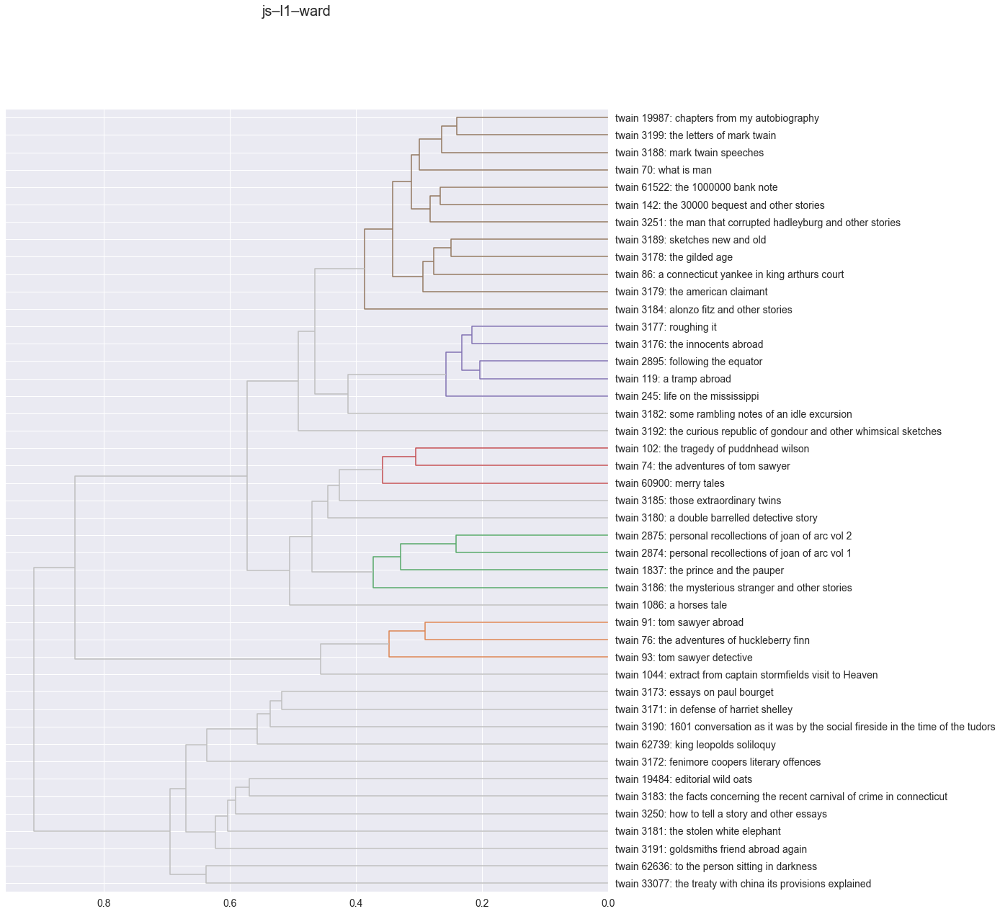

<Figure size 432x288 with 0 Axes>

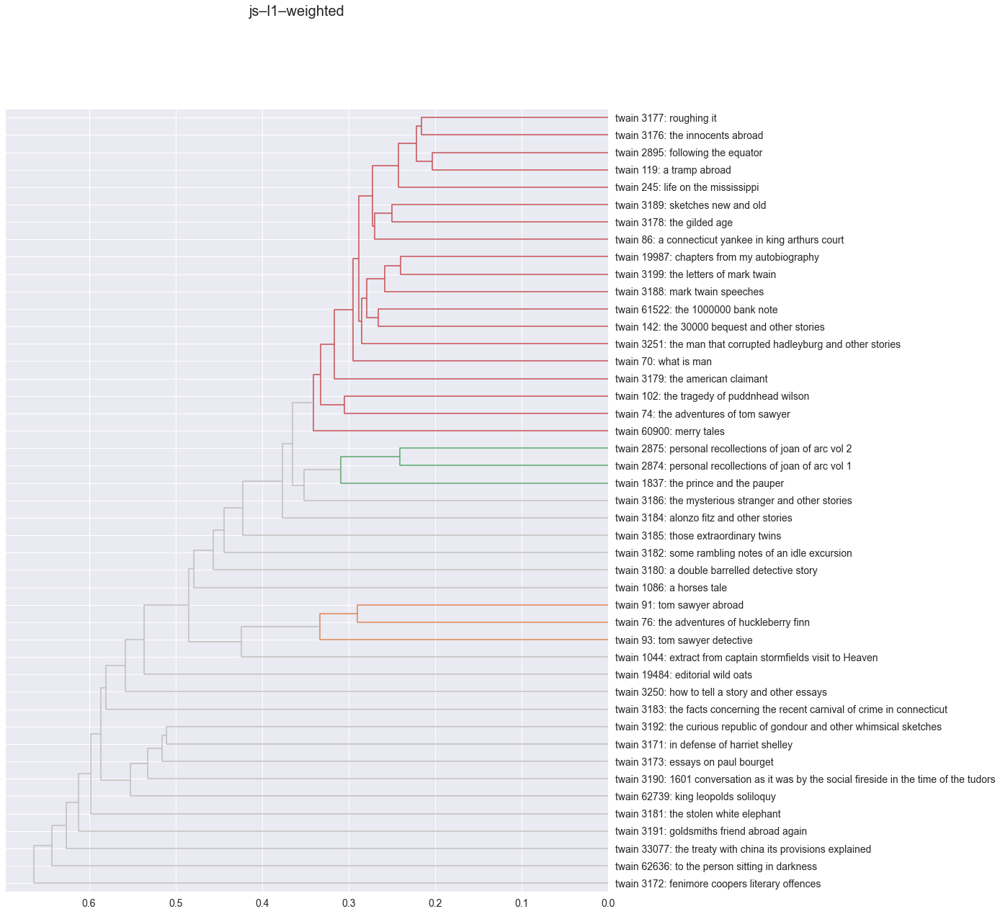

<Figure size 432x288 with 0 Axes>

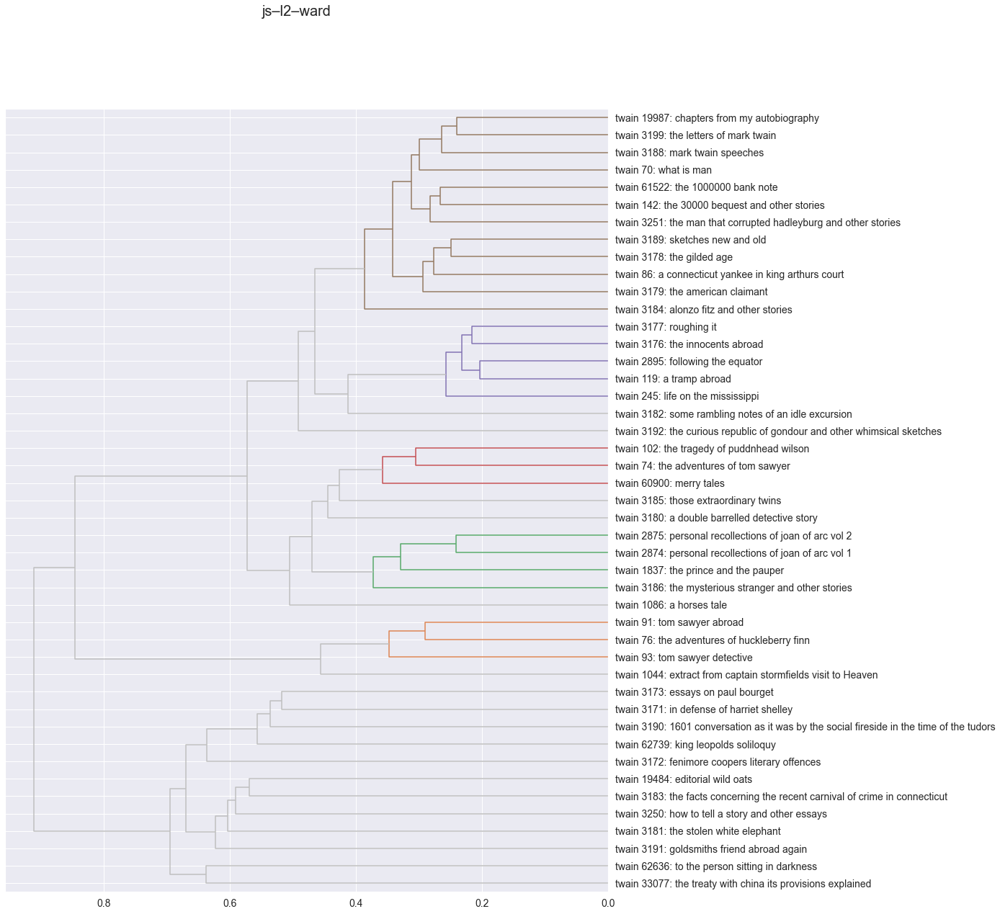

<Figure size 432x288 with 0 Axes>

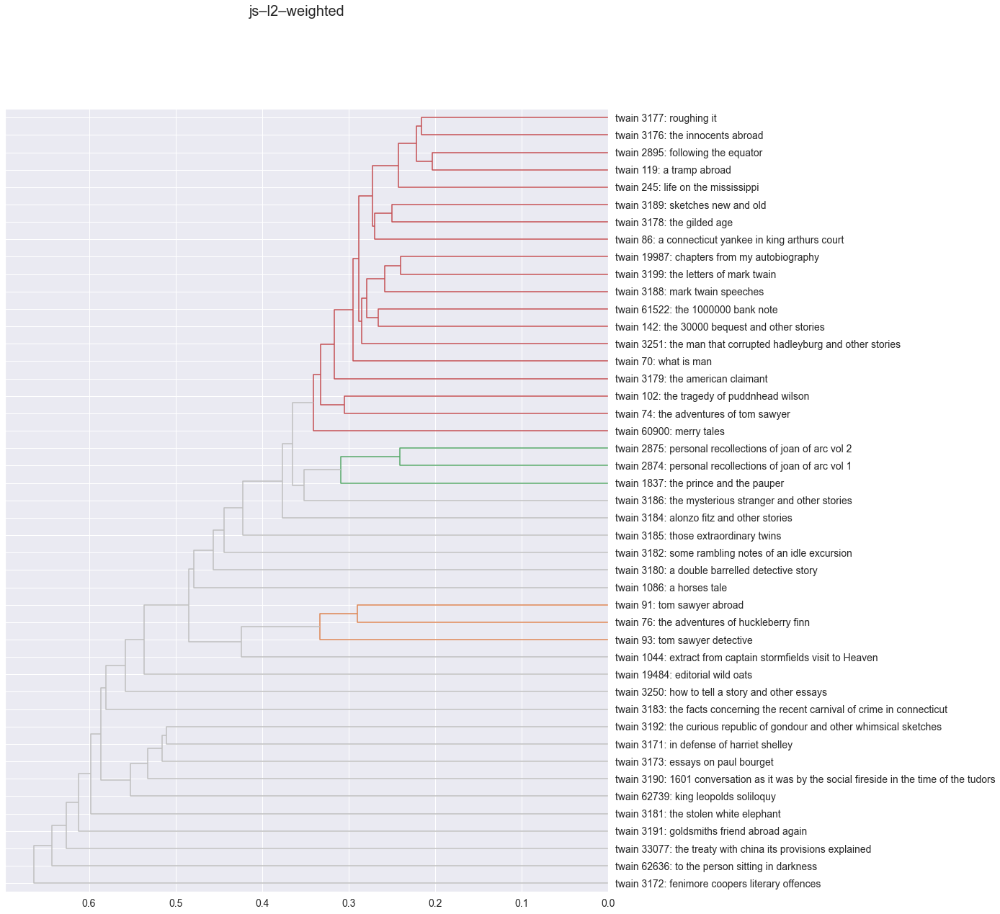

In [141]:
for combo in combos:
    # column in df (i.e., distance metric)
    m = combo[-1]
    
    # two lnikage methods
    for l in ['ward','weighted']:
        # title: distance metric - linkage method
        title = f"{m}–{l}"
        hca(PAIRS[m], title, linkage_method=l)

### **Top 20 nouns by DFIDF, sorted in descending order (including plural nouns but not proper nouns)**

In [70]:
# noun taglist (excluding proper nouns)
noun_tags = ['NN', 'NNS']

SIGS.loc[SIGS.max_pos.isin(noun_tags)].sort_values('dfidf', ascending = False).head(20)

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster,term_rank2,zipf_k,zipf_k2,tfidf_mean_chap_max,tfidf_max_chap_max,df,idf,dfidf
term_str,,,,,,,,,,,,,,,,,,,,
indeed,373,758,6,0.000255,11.936159,NN,12,"{'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'POS', 'IN'...",0,inde,inde,indee,351,282734,266058,0.018638,0.220656,410.0,1.434262,588.047447
door,319,885,4,0.000298,11.712680,NN,8,"{'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'FW', 'JJ',...",0,door,door,door,306,282315,270810,0.021854,0.290393,405.0,1.451964,588.045448
deal,414,682,4,0.000230,12.088585,NN,4,"{'VBP', 'VB', 'NN', 'NNP'}",0,deal,deal,deal,385,282348,262570,0.015758,0.110058,411.0,1.430748,588.037256
children,317,890,8,0.000300,11.704552,NNS,9,"{'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'VBN', 'VBP...",0,children,children,childr,305,282130,271450,0.021761,0.323451,404.0,1.455531,588.034396
money,244,1226,5,0.000413,11.242470,NN,12,"{'PDT', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'VBN...",0,money,money,money,239,299144,293014,0.027533,0.190299,412.0,1.427242,588.023555
ones,402,704,4,0.000237,12.042782,NNS,16,"{'NNPS', 'RP', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP...",0,one,one,on,375,283008,264000,0.016453,0.128745,403.0,1.459106,588.019773
miles,263,1117,5,0.000376,11.376800,NNS,9,"{'PDT', 'VBZ', 'NNS', 'VB', 'VBD', 'NNP', 'VBP...",0,mile,mile,mil,257,293771,287069,0.027528,0.209469,401.0,1.466284,587.979780
everybody,339,842,9,0.000283,11.784537,NN,12,"{'RBR', 'RP', 'VBG', 'NNS', 'VB', 'VBD', 'NNP'...",0,everybodi,everybodi,everybody,321,285438,270282,0.018832,0.137107,415.0,1.416775,587.961476
family,297,988,6,0.000333,11.553846,NN,10,"{'VBZ', 'NNS', 'VBD', 'NNP', 'VBN', 'RB', 'MD'...",0,famili,famili,famy,287,293436,283556,0.021444,0.212516,415.0,1.416775,587.961476


In [71]:
top_20_nouns = list(VOCAB.loc[VOCAB.max_pos.isin(noun_tags)].sort_values('dfidf', ascending = False).head(20).index)

In [72]:
print(top_20_nouns)

['indeed', 'door', 'deal', 'children', 'money', 'ones', 'miles', 'family', 'everybody', 'ground', 'friend', 'state', 'none', 'friends', 'chance', 'air', 'city', 'words', 'hours', 'nobody']


### **Most "Significant" Book based on mean TFIDF**

In [73]:
BOW.groupby(BOOKS).mean().sort_values('tfidf', ascending = False).join(LIB, on = 'book_id')

,n,tf,tfidf,source_file_path,title,chap_regex,author,type,year,decade,n_chaps,book_len,label
book_id,,,,,,,,,,,,,
3188,2.540928,0.054027,0.078733,Twain/3188-mark_twain_speeches.txt,mark twain speeches,INTRODUCTION$|PREFACE$|THE STORY OF A SPEECH$|...,twain,non-fiction,1880,1880,105,92256,twain 3188: mark twain speeches
3191,2.330049,0.043699,0.062809,Twain/3191-goldsmiths_friend_abroad_again.txt,goldsmiths friend abroad again,LETTER\s[IVXLCM]+,twain,stories,1870,1870,7,6149,twain 3191: goldsmiths friend abroad again
1086,2.659144,0.040938,0.059174,Twain/1086-a_horses_tale.txt,a horses tale,^[IVXLCM]+$,twain,novel,1907,1900,15,17085,twain 1086: a horses tale
3192,2.431230,0.032768,0.057134,Twain/3192-the_curious_republic_of_gondour_and...,the curious republic of gondour and other whim...,THE CURIOUS REPUBLIC OF GONDOUR|A MEMORY|INTRO...,twain,stories,1919,1910,14,16722,twain 3192: the curious republic of gondour an...
3250,2.963259,0.032567,0.051521,Twain/3250-how_to_tell_a_story_and_other_essay...,how to tell a story and other essays,HOW TO TELL A STORY$|THE WOUNDED SOLDIER.$|THE...,twain,non-fiction,1897,1890,5,7420,twain 3250: how to tell a story and other essays
3189,2.875911,0.027712,0.045378,Twain/3189-sketches_new_and_old.txt,sketches new and old,MY WATCH|POLITICAL ECONOMY|THE JUMPING FROG|JO...,twain,stories,1916,1910,52,97108,twain 3189: sketches new and old
102,3.021061,0.026733,0.043308,Twain/102-the_tragedy_of_puddnhead_wilson.txt,the tragedy of puddnhead wilson,^(?:A Whisper|CHAPTER\s[IVXLCM]+\.|CONCLUSION)$,twain,novel,1894,1890,22,53935,twain 102: the tragedy of puddnhead wilson
19484,2.700829,0.026177,0.042429,Twain/19484-editorial_wild_oats.txt,editorial wild oats,^My First Literary Venture$|^Journalism in Ten...,twain,stories,1875,1870,5,9777,twain 19484: editorial wild oats
74,2.786740,0.026721,0.041384,Twain/74-the_adventures_of_tom_sawyer.txt,the adventures of tom sawyer,^\s*CHAPTER\s*[IVXLCM]+$,twain,novel,1876,1870,35,70276,twain 74: the adventures of tom sawyer


### **Compare Distributions**

In [74]:
# merge PAIRS, LIB to add label col twice (for doc_a, doc_b) to include author, book_id, title

DISTS = pd.merge(PAIRS.reset_index(), LIB['label'], left_on = 'doc_a', right_on = 'book_id', how = 'left')
                                                                                                                                                                                                                                                      
DISTS = pd.merge(DISTS, LIB['label'], left_on = 'doc_b', right_on = 'book_id', how = 'right')

DISTS = DISTS.set_index(['doc_a', 'doc_b']).rename({'label_x': 'label_a', 'label_y': 'label_b'}, axis = 1)

In [75]:
# reorder df columns so that label_a and label_b first

DISTS.insert(loc = 0, column = 'label_a', value = DISTS.pop('label_a'))

DISTS.insert(loc = 1, column = 'label_b', value = DISTS.pop('label_b'))

In [76]:
DISTS.head(20).style.background_gradient(cmap='YlGnBu', high=.5, axis=0)

,,label_a,label_b,corr_raw,cityblock–raw,euclidean–raw,euclidean–l2,cosine–raw,cityblock–l1,jaccard–l0,js–l0,js–l1,js–l2
doc_a,doc_b,,,,,,,,,,,,
74.0,70.0,twain 74: the adventures of tom sawyer,twain 70: what is man,0.934347,4.546088,0.234767,0.939812,0.441623,0.810756,0.037000,0.114145,0.368884,0.368884
76.0,70.0,twain 76: the adventures of huckleberry finn,twain 70: what is man,1.006768,4.975003,0.297118,1.093061,0.597391,0.996911,0.128000,0.216051,0.448822,0.448822
86.0,70.0,twain 86: a connecticut yankee in king arthurs court,twain 70: what is man,0.920990,4.889381,0.292809,1.114627,0.621196,1.037877,0.233233,0.297915,0.466381,0.466381
91.0,70.0,twain 91: tom sawyer abroad,twain 70: what is man,1.002018,3.006633,0.140112,0.758177,0.287416,0.623418,0.006000,0.045661,0.283683,0.283683
93.0,70.0,twain 93: tom sawyer detective,twain 70: what is man,1.028131,4.887719,0.249661,1.002306,0.502308,0.993955,0.259519,0.315950,0.447095,0.447095
102.0,70.0,twain 102: the tragedy of puddnhead wilson,twain 70: what is man,0.958330,5.277857,0.308049,0.978975,0.479196,0.912322,0.310241,0.349162,0.430125,0.430125
119.0,70.0,twain 119: a tramp abroad,twain 70: what is man,0.889692,4.536682,0.225397,0.870263,0.378679,0.717113,0.031000,0.104361,0.328523,0.328523
142.0,70.0,twain 142: the 30000 bequest and other stories,twain 70: what is man,0.749916,3.710108,0.191821,0.896461,0.401821,0.754953,0.058058,0.143522,0.350748,0.350748
245.0,70.0,twain 245: life on the mississippi,twain 70: what is man,0.914644,3.392531,0.163527,0.783583,0.307001,0.645965,0.009000,0.055975,0.294312,0.294312


### **Compare Z normalized distributions**

In [77]:
ZPAIRS = (PAIRS - PAIRS.mean()) / PAIRS.std()

In [78]:
ZPAIRS

corr_raw  cityblock–raw  euclidean–raw  euclidean–l2  cosine–raw  \
doc_a doc_b                                                                     
74    70     0.201052      -0.616593      -0.623747     -0.440606   -0.516566   
76    70     0.831302      -0.291196       0.087454      0.572656    0.538375   
      74    -3.574216      -1.427193      -1.268485     -1.069729   -1.091531   
86    70     0.084815      -0.356153       0.038305      0.715245    0.699595   
      74    -0.469586       0.115506       0.560733      0.961805    0.985803   
...               ...            ...            ...           ...         ...   
62739 19987  0.037397       1.906864       1.518612      1.177751    1.244211   
      33077 -0.602780       0.723475       0.241571      0.926680    0.944455   
      60900  1.019339       1.072599       1.019166      0.915623    0.931478   
      61522  0.759148      -0.323417      -0.658215      0.479398    0.434635   
      62636 -0.005703       0.528097       1.206798      1.262290    1.347341   

             cityblock–l1  jaccard–l0     js–l0     js–l1     js–l2  
doc_a doc_b                                                          
74    70        -0.710584   -1.275181 -1.294188 -0.784200 -0.784200  
76    70         0.064428   -0.831873 -0.657971 -0.032502 -0.032502  
      74        -1.386310   -1.416455 -1.677430 -1.433436 -1.433436  
86    70         0.234977   -0.319228 -0.146881  0.132609  0.132609  
      74         0.606981    0.059614  0.178596  0.538261  0.538261  
...                   ...         ...       ...       ...       ...  
62739 19987      1.500613    1.585456  1.369783  1.383700  1.383700  
      33077      0.780878    0.284041  0.373695  0.716812  0.716812  
      60900      1.284908    1.583729  1.355870  1.221409  1.221409  
      61522      0.528006    0.242222  0.326035  0.443758  0.443758  
      62636      1.425303    1.582722  1.447839  1.470754  1.470754  

[990 rows x 10 columns]

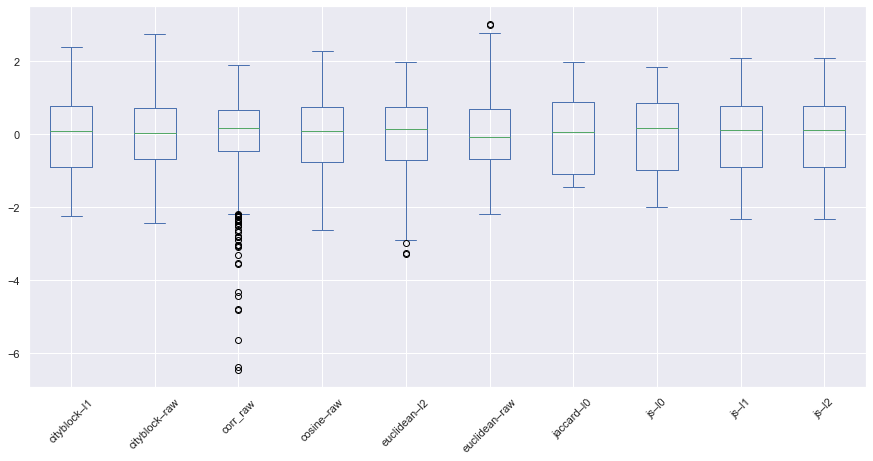

In [79]:
ZPAIRS.T.sort_index().T.plot.box(rot = 45, figsize = (15,7));

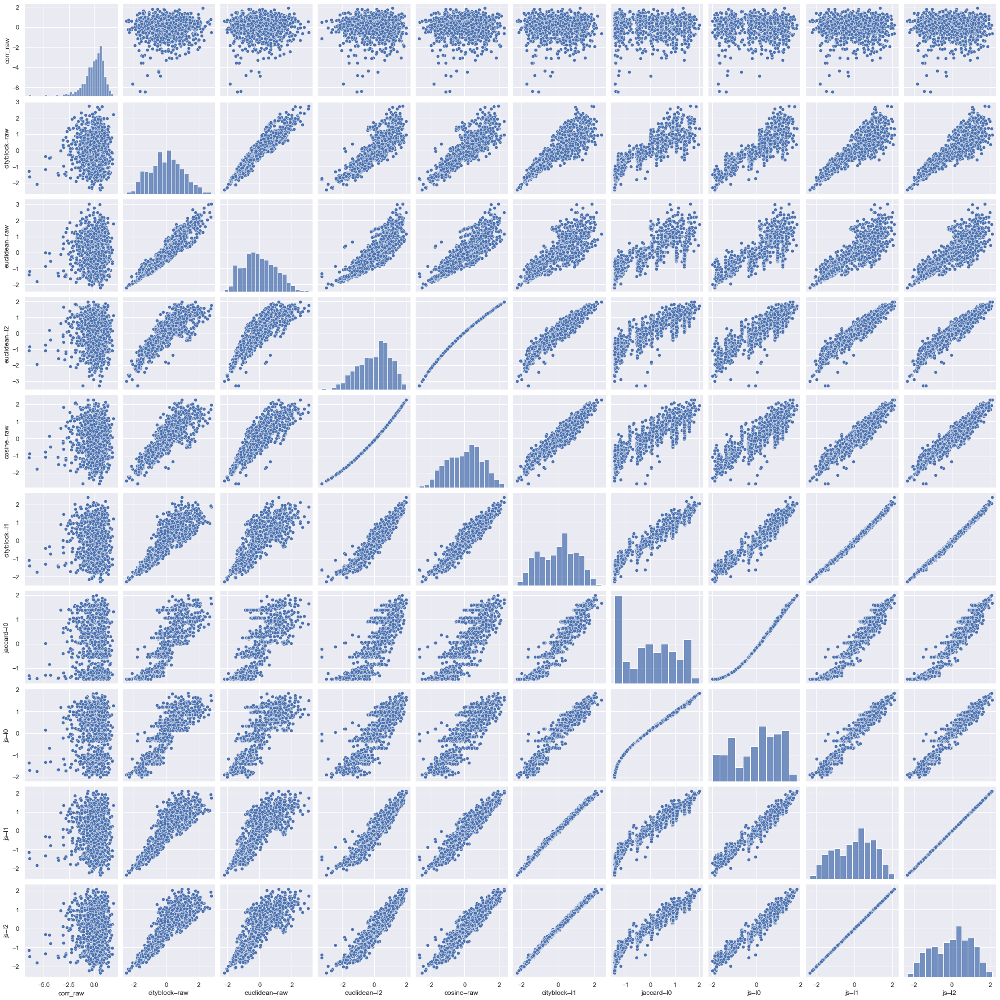

In [80]:
sns.pairplot(ZPAIRS);

### **K-Means**

**[Alogirthm Overview](https://en.wikipedia.org/wiki/K-means_clustering)**
* Goal: partition n observations of d-dimenstional real vectors so as to minimize the within-cluster sum of squares (WCSS), or variance
* Steps
    * Given an initial set of k means
    * Assignment setep: assign each observation to cluster with the nearest mean (centroid: multivariate mean in Euclidean space) based on Euclidean distance
        * Euclidean distance: $\sqrt{\sum_{i=1}^{n}(x_i - y_i)^2}$
        * Important to scale features to prevent those on larger scales from dominating
    * Update step: recalculate the means (centroids) for observations assigned to each cluster
    * Converged when assignemnts no longer change

In [81]:
n_clusters = 4

In [82]:
# instantiate KMeans model
km = KMeans(n_clusters, random_state = 314)

# compute cluster centers and predict cluster index for each sample using raw and normalized feature vectors
book_DOC['y_raw'] = km.fit_predict(mean_TFIDF_sigs)
book_DOC['y_L0'] = km.fit_predict(L0)
book_DOC['y_L1'] = km.fit_predict(L1)
book_DOC['y_L2'] = km.fit_predict(L2)

In [83]:
book_DOC.iloc[:,1:].sort_values('label').style.background_gradient(cmap = 'RdBu')

,title,label,y_raw,y_L0,y_L1,y_L2
book_id,,,,,,
102,the tragedy of puddnhead wilson,twain 102: the tragedy of puddnhead wilson,0,0,0,1
1044,extract from captain stormfields visit to Heaven,twain 1044: extract from captain stormfields visit to Heaven,2,3,3,2
1086,a horses tale,twain 1086: a horses tale,0,0,0,1
119,a tramp abroad,twain 119: a tramp abroad,0,0,0,0
142,the 30000 bequest and other stories,twain 142: the 30000 bequest and other stories,0,0,0,0
1837,the prince and the pauper,twain 1837: the prince and the pauper,0,0,0,1
19484,editorial wild oats,twain 19484: editorial wild oats,0,1,0,0
19987,chapters from my autobiography,twain 19987: chapters from my autobiography,0,0,0,0
245,life on the mississippi,twain 245: life on the mississippi,0,0,0,0


In [84]:
# k values to test
k_vals = list(range(2, 11))

# different feature vectors to use
feature_vectors = {'raw': mean_TFIDF_sigs,
                   'L0': L0,
                   'L1': L1,
                   'L2': L2}

# empty dataframe
km_results = pd.DataFrame(columns = ['k', 'raw_silhouette_score', 'L0_silhouette_score', 'L1_silhouette_score', 'L2_silhouette_score'])

# loop through k values (num of clusters) and compute silhouette score to find best of combo of k, feature vector
for k in k_vals:
    km = KMeans(k, random_state = 314)
    
    results = [k]
    
    for vec in feature_vectors.values():
        labels = km.fit_predict(vec)
        
        results.append(silhouette_score(vec, labels))
    
    km_results.loc[len(km_results)] = results

In [85]:
km_results.style.background_gradient(cmap = 'RdBu', axis = None, subset = km_results.columns[1:])

,k,raw_silhouette_score,L0_silhouette_score,L1_silhouette_score,L2_silhouette_score
0,2.000000,0.255373,0.377931,0.236509,0.091829
1,3.000000,0.259579,0.342163,0.242996,0.064479
2,4.000000,0.248763,0.337037,0.240644,0.054186
3,5.000000,0.138738,0.336095,0.247383,0.054036
4,6.000000,0.245425,0.336220,0.057003,0.042060
5,7.000000,0.142032,0.327749,0.219367,0.047595
6,8.000000,0.136787,0.335951,0.047044,0.057804
7,9.000000,0.072876,0.330097,0.045014,0.042156
8,10.000000,0.049228,0.311804,0.087053,0.044631


In [86]:
km_results.iloc[:, 1:].idxmax()

raw_silhouette_score    1
L0_silhouette_score     0
L1_silhouette_score     3
L2_silhouette_score     0
dtype: int64

In [87]:
# overall highest silhouette score
max_silhouette_score = km_results.iloc[:,1:].max().max()

# k value (num of clusters) corresponding to the highest silhouette score
max_score_cluster = km_results.loc[km_results[km_results == max_silhouette_score].any(axis = 1)]['k'].iloc[0]

# feature vector corresponding to the highest silhouette score
max_score_vec = km_results.loc[km_results[km_results == max_silhouette_score].any(axis = 1)].iloc[:, 1:].idxmax(axis = 1).iloc[0]

In [88]:
# create a col with labels corresponding to k value, feature vector that yield highest silhouette score
km = KMeans(int(max_score_cluster), random_state = 314)

max_col_name = 'max_y_{}'.format(max_score_vec.split('_')[0])

book_DOC[max_col_name] = km.fit_predict(feature_vectors[max_score_vec.split('_')[0]])

In [89]:
# add to see cluster breakdown by type
book_DOC = book_DOC.join(LIB['type'])

In [90]:
book_DOC[['label', 'type', max_col_name]].sort_values(max_col_name).style.background_gradient(cmap = 'RdBu')

,label,type,max_y_L0
book_id,,,
62739,twain 62739: king leopolds soliloquy,stories,0
62636,twain 62636: to the person sitting in darkness,non-fiction,0
3173,twain 3173: essays on paul bourget,non-fiction,0
3172,twain 3172: fenimore coopers literary offences,non-fiction,0
3171,twain 3171: in defense of harriet shelley,non-fiction,0
3190,twain 3190: 1601 conversation as it was by the social fireside in the time of the tudors,stories,0
3183,twain 3183: the facts concerning the recent carnival of crime in connecticut,stories,0
1044,twain 1044: extract from captain stormfields visit to Heaven,stories,0
3191,twain 3191: goldsmiths friend abroad again,stories,0


In [91]:
book_DOC.groupby(max_col_name).size()

max_y_L0
0    14
1    31
dtype: int64

In [92]:
# cluster breakdown by type
book_DOC.groupby(['type', max_col_name]).size()

type         max_y_L0
non-fiction  0            6
             1           11
novel        0            1
             1           10
stories      0            7
             1           10
dtype: int64

## **M07: Features and Components**

In [93]:
TFIDF_sigs

term_str           saying      seem    indeed   couldnt      door     taken  \
book_id chap_id                                                               
70      1        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        2        0.005272  0.005285  0.005246  0.010622  0.001062  0.004187   
        3        0.006831  0.000000  0.000000  0.006881  0.055051  0.000000   
        4        0.005859  0.000000  0.005830  0.005902  0.000000  0.000000   
        5        0.008429  0.012674  0.004194  0.012737  0.004246  0.004183   
...                   ...       ...       ...       ...       ...       ...   
62739   2        0.016015  0.008027  0.003984  0.004033  0.000000  0.003974   
        3        0.045041  0.045152  0.000000  0.000000  0.000000  0.000000   
        4        0.005093  0.005106  0.005068  0.010261  0.005131  0.000000   
        5        0.000000  0.000000  0.000000  0.000000  0.000000  0.013626   
        6        0.000000  0.000000  0.000000  0.000000  0.000000  0.043356   

term_str             deal     fifty   getting   perhaps  ...     shame  \
book_id chap_id                                          ...             
70      1        0.000000  0.000000  0.000000  0.000000  ...  0.000000   
        2        0.002093  0.004187  0.002130  0.014907  ...  0.013009   
        3        0.000000  0.006781  0.006898  0.000000  ...  0.000000   
        4        0.011632  0.017448  0.000000  0.011834  ...  0.000000   
        5        0.004183  0.012550  0.008512  0.008512  ...  0.000000   
...                   ...       ...       ...       ...  ...       ...   
62739   2        0.003974  0.000000  0.000000  0.000000  ...  0.024700   
        3        0.000000  0.044711  0.000000  0.000000  ...  0.000000   
        4        0.000000  0.005056  0.005143  0.000000  ...  0.010473   
        5        0.013626  0.000000  0.000000  0.000000  ...  0.000000   
        6        0.000000  0.000000  0.000000  0.000000  ...  0.000000   

term_str             dawn  privilege     loved      busy    record   watched  \
book_id chap_id                                                                
70      1        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        2        0.000000   0.002168  0.002168  0.002168  0.006505  0.006505   
        3        0.000000   0.000000  0.042142  0.000000  0.000000  0.000000   
        4        0.012049   0.024098  0.000000  0.000000  0.000000  0.000000   
        5        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
...                   ...        ...       ...       ...       ...       ...   
62739   2        0.000000   0.000000  0.000000  0.008233  0.024700  0.000000   
        3        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        4        0.000000   0.000000  0.000000  0.010473  0.010473  0.000000   
        5        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        6        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   

term_str             laws  information  questions  
book_id chap_id                                    
70      1        0.000000          0.0   0.000000  
        2        0.006505          0.0   0.002168  
        3        0.000000          0.0   0.000000  
        4        0.000000          0.0   0.012049  
        5        0.000000          0.0   0.000000  
...                   ...          ...        ...  
62739   2        0.000000          0.0   0.000000  
        3        0.000000          0.0   0.000000  
        4        0.000000          0.0   0.000000  
        5        0.000000          0.0   0.000000  
        6        0.000000          0.0   0.000000  

[1108 rows x 1000 columns]

In [94]:
chap_DOC = pd.DataFrame(index = TFIDF.index)

chap_DOC = chap_DOC.join(LIB[['author', 'title', 'type', 'decade']], on = 'book_id')

chap_DOC['label'] = chap_DOC.apply(lambda x: "{}-{}-{}".format(x.name[0], x.author, x.name[1]), 1)

chap_DOC['mean_tfidf'] = TFIDF.mean(1)

chap_DOC['n_tokens'] = BOW.groupby(OHCO[:2]).n.sum()

In [95]:
chap_DOC

author                    title         type  decade  \
book_id chap_id                                                        
70      1        twain              what is man  non-fiction    1900   
        2        twain              what is man  non-fiction    1900   
        3        twain              what is man  non-fiction    1900   
        4        twain              what is man  non-fiction    1900   
        5        twain              what is man  non-fiction    1900   
...                ...                      ...          ...     ...   
62739   2        twain  king leopolds soliloquy      stories    1900   
        3        twain  king leopolds soliloquy      stories    1900   
        4        twain  king leopolds soliloquy      stories    1900   
        5        twain  king leopolds soliloquy      stories    1900   
        6        twain  king leopolds soliloquy      stories    1900   

                         label  mean_tfidf  n_tokens  
book_id chap_id                                       
70      1           70-twain-1    0.000506        71  
        2           70-twain-2    0.000605     26698  
        3           70-twain-3    0.000507      4367  
        4           70-twain-4    0.000380      3669  
        5           70-twain-5    0.000419      5465  
...                        ...         ...       ...  
62739   2        62739-twain-2    0.000536      6390  
        3        62739-twain-3    0.000782       686  
        4        62739-twain-4    0.000420      3033  
        5        62739-twain-5    0.000354      1129  
        6        62739-twain-6    0.000428       356  

[1108 rows x 7 columns]

In [96]:
TFIDF_sigs

term_str           saying      seem    indeed   couldnt      door     taken  \
book_id chap_id                                                               
70      1        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        2        0.005272  0.005285  0.005246  0.010622  0.001062  0.004187   
        3        0.006831  0.000000  0.000000  0.006881  0.055051  0.000000   
        4        0.005859  0.000000  0.005830  0.005902  0.000000  0.000000   
        5        0.008429  0.012674  0.004194  0.012737  0.004246  0.004183   
...                   ...       ...       ...       ...       ...       ...   
62739   2        0.016015  0.008027  0.003984  0.004033  0.000000  0.003974   
        3        0.045041  0.045152  0.000000  0.000000  0.000000  0.000000   
        4        0.005093  0.005106  0.005068  0.010261  0.005131  0.000000   
        5        0.000000  0.000000  0.000000  0.000000  0.000000  0.013626   
        6        0.000000  0.000000  0.000000  0.000000  0.000000  0.043356   

term_str             deal     fifty   getting   perhaps  ...     shame  \
book_id chap_id                                          ...             
70      1        0.000000  0.000000  0.000000  0.000000  ...  0.000000   
        2        0.002093  0.004187  0.002130  0.014907  ...  0.013009   
        3        0.000000  0.006781  0.006898  0.000000  ...  0.000000   
        4        0.011632  0.017448  0.000000  0.011834  ...  0.000000   
        5        0.004183  0.012550  0.008512  0.008512  ...  0.000000   
...                   ...       ...       ...       ...  ...       ...   
62739   2        0.003974  0.000000  0.000000  0.000000  ...  0.024700   
        3        0.000000  0.044711  0.000000  0.000000  ...  0.000000   
        4        0.000000  0.005056  0.005143  0.000000  ...  0.010473   
        5        0.013626  0.000000  0.000000  0.000000  ...  0.000000   
        6        0.000000  0.000000  0.000000  0.000000  ...  0.000000   

term_str             dawn  privilege     loved      busy    record   watched  \
book_id chap_id                                                                
70      1        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        2        0.000000   0.002168  0.002168  0.002168  0.006505  0.006505   
        3        0.000000   0.000000  0.042142  0.000000  0.000000  0.000000   
        4        0.012049   0.024098  0.000000  0.000000  0.000000  0.000000   
        5        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
...                   ...        ...       ...       ...       ...       ...   
62739   2        0.000000   0.000000  0.000000  0.008233  0.024700  0.000000   
        3        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        4        0.000000   0.000000  0.000000  0.010473  0.010473  0.000000   
        5        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   
        6        0.000000   0.000000  0.000000  0.000000  0.000000  0.000000   

term_str             laws  information  questions  
book_id chap_id                                    
70      1        0.000000          0.0   0.000000  
        2        0.006505          0.0   0.002168  
        3        0.000000          0.0   0.000000  
        4        0.000000          0.0   0.012049  
        5        0.000000          0.0   0.000000  
...                   ...          ...        ...  
62739   2        0.000000          0.0   0.000000  
        3        0.000000          0.0   0.000000  
        4        0.000000          0.0   0.000000  
        5        0.000000          0.0   0.000000  
        6        0.000000          0.0   0.000000  

[1108 rows x 1000 columns]

### **Manual PCA Methods with Only 1000 Most Significant Terms (excluding proper nouns)**

In [97]:
LOADINGS, DCM, COMPINF = get_pca(TFIDF_sigs, norm_docs = True, center_by_mean = False, center_by_variance = False)

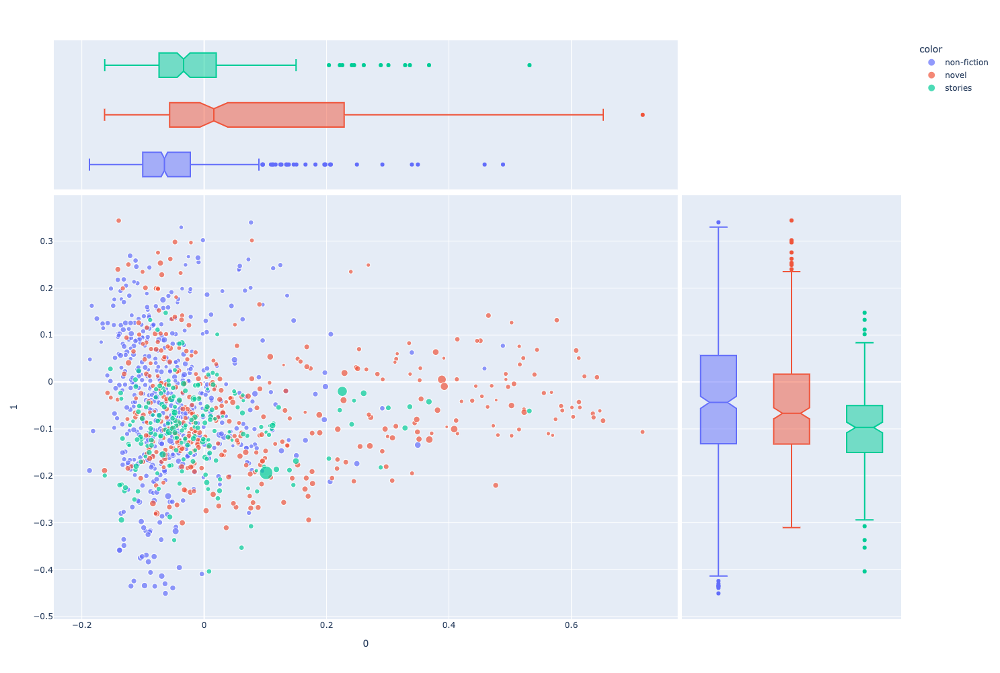

In [98]:
px.scatter(DCM, 0, 1, color=chap_DOC.type, 
           size=np.abs(chap_DOC.mean_tfidf), hover_name=chap_DOC.label, 
           marginal_x='box', marginal_y='box', height=1000)

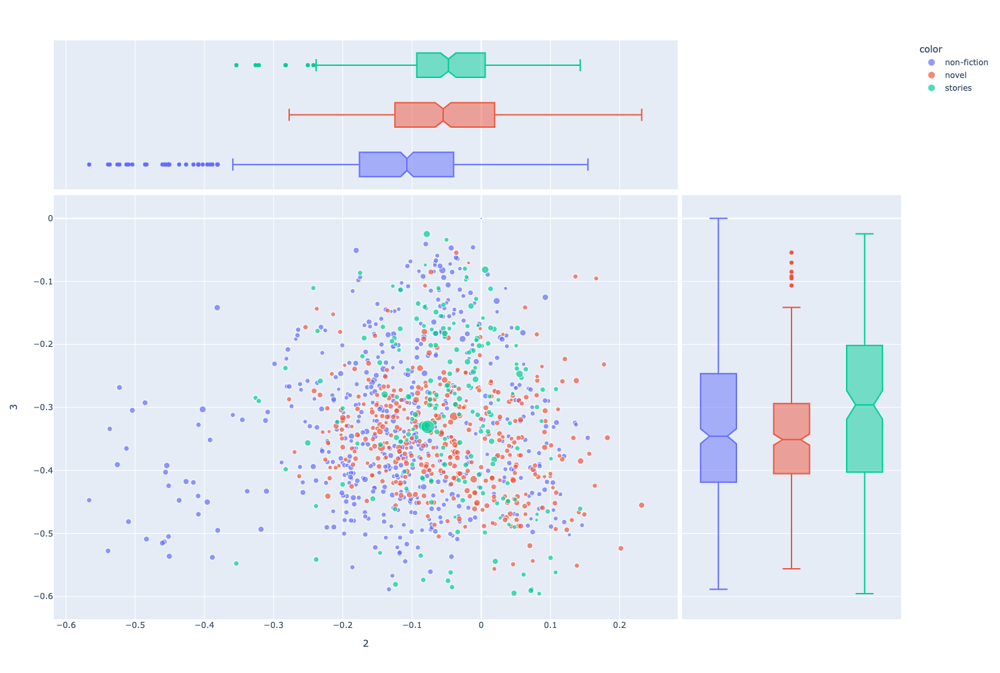

In [99]:
px.scatter(DCM, 2, 3, color=chap_DOC.type, 
           size=np.abs(chap_DOC.mean_tfidf), hover_name=chap_DOC.label, 
           marginal_x='box', marginal_y='box', height=1000)

In [100]:
X = LOADINGS.join(SIGS, how='inner').reset_index()

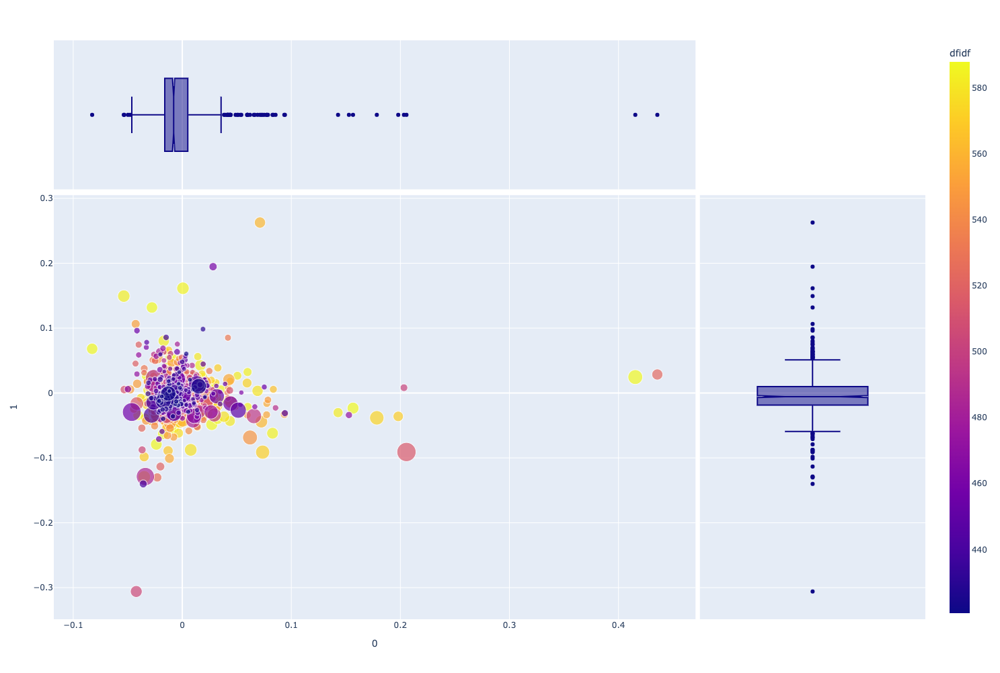

In [101]:
px.scatter(X, 0, 1, size=X.n, color=X.dfidf, 
           hover_name='term_str', hover_data=['max_pos'], 
           marginal_x='box', marginal_y='box', 
           height=1000, width=1000)

In [102]:
COMPINF

,pos,neg,eig_val,exp_var
pc_id,,,,
0,aint says dont reckon thats,city feet government french war,0.025783,0.224980
1,river boat water feet miles,letter letters wrote book am,0.016925,0.147683
2,sir court face voice father,letter letters book river wrote,0.013273,0.115819
3,bill american sir honor government,letter feet oh mother boys,0.012755,0.111299
4,says city aint church sea,river boat sir letter shore,0.009164,0.079961
5,sir government dollars bill money,letter letters book boys mother,0.008131,0.070952
6,sir letter ship sea letters,river french government boat war,0.007849,0.068485
7,dollars money boys silver boy,says sir french ship sea,0.007382,0.064418
8,ship boat sea dont oh,says dollars letter silver gold,0.006870,0.059950


### **Prince PCA Method with entire TFIDF**

In [103]:
pca = PCA(
    n_components=6,
    n_iter=3,
    rescale_with_mean=False, # Already set and applied to TFIDF
    rescale_with_std=False, # Already set and applied to TFIDF
    copy=True,
    check_input=True,
    engine='auto',
    random_state=42
)

In [104]:
pca = pca.fit(TFIDF)

In [105]:
dcm = pca.transform(TFIDF)

In [106]:
dcm

0         1         2         3         4         5
book_id chap_id                                                            
70      1        0.113931  0.302671 -0.170870  0.040518 -0.037079 -0.075492
        2        0.120829  0.241899 -0.146759 -0.027912 -0.016165  0.163990
        3        0.162728  0.294099 -0.166797 -0.021350 -0.015659 -0.026615
        4        0.075285  0.150127 -0.085885 -0.019615 -0.021718  0.001746
        5        0.091257  0.178199 -0.095310 -0.023824 -0.011637 -0.013031
...                   ...       ...       ...       ...       ...       ...
62739   2        0.102761  0.195586 -0.099366 -0.025425 -0.013681 -0.010889
        3        0.138763  0.272401 -0.149855 -0.030387 -0.053265 -0.013249
        4        0.055947  0.124940 -0.060920 -0.019205 -0.005833 -0.005138
        5        0.061812  0.135055 -0.077031 -0.020244 -0.007853 -0.007598
        6        0.065727  0.158000 -0.077146 -0.014555 -0.012263  0.021367

[1108 rows x 6 columns]

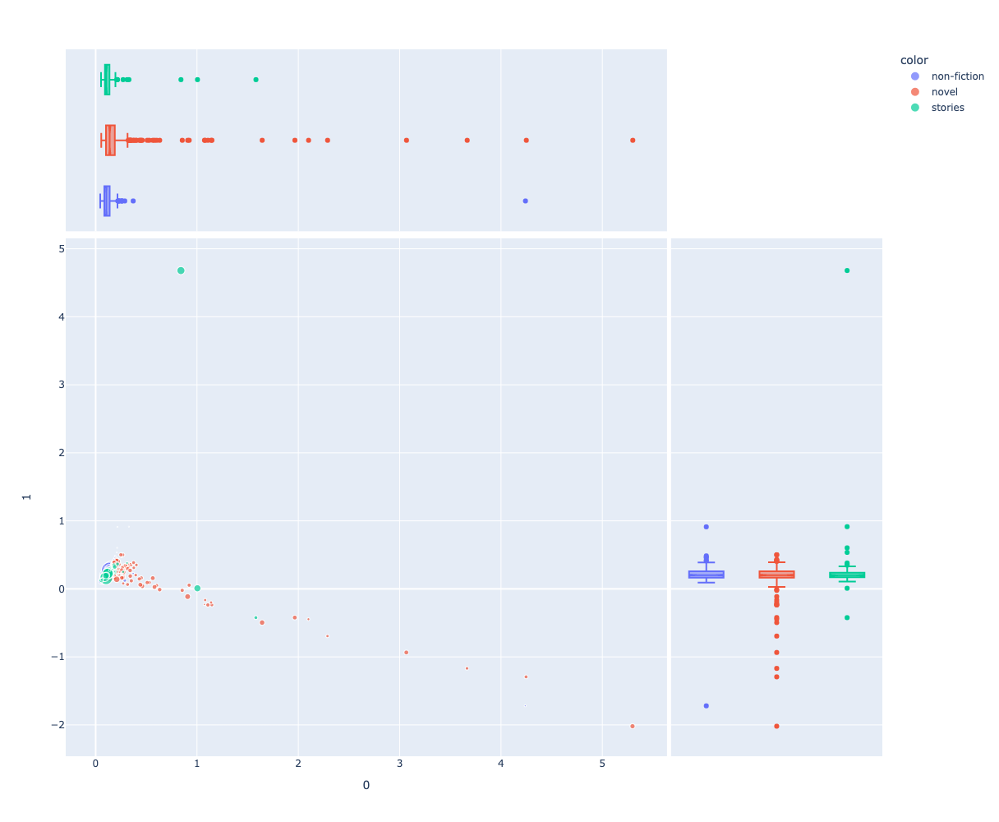

In [107]:
px.scatter(dcm, 0, 1, 
           color=chap_DOC.type,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

### **THERE ARE OUTLIERS IN THE ABOVE PLOT THAT ARE SKEWING THE RESULTS**

#### **It seems as though the first principal component (PC 0) is for vernacular and the second one (PC 1) is for German**

#### ***The Adventures of Huckleberry Finn* (76)**

* Chapter 4: lots of vernacular and misspellings
* Chapter 8: lots of vernacular and misspellings
* Chapter 15: lots of vernacular and misspellings
* Chapter 23: lots of vernacular and misspellings
* Chapter 38: lots of vernacular and misspellings
* Chapter 43: lots of vernacular and misspellings

#### ***Mark Twain Speeches* (3188)**

* Chapter 10: "A New German Word" $\rightarrow$ contains a "German" word

#### ***The Tragedy of Pudd'nhead Wilson* (102)**

**Note that the chapter numbers listed below are one chapter greater than those in the book (e.g., Chapter 4 below is actually Chapter 14) but there is an intro**
* Chapter 4 (Roxy Plays a Shrewd Trick): lots of vernacular and misspellings
* Chapter 9 (Marse Tom Tramples His Chance): lots of vernacular and misspellings
* Chapter 10 (Tom Practises Syncophancy): lots of vernacular and misspellings
* Chapter 15 (Roxana Insists Upeon Reform): lots of vernacular and misspellings
* Chapter 19 (Roxana Commands): lots of vernacular and misspellings

#### ***How to Tell A Story and Other Essays* (3250)**

* Chapter 3: "The Golden Arm" $\rightarrow$ lots of vernacular and misspellings

#### ***Merry Tales* (60900)**
* Ch. 6: "Meisterschaft" play $\rightarrow$ speaking German

#### ***Sketches New and Old* (3189)**

* Chapter 3: "The Jumping Frog" $\rightarrow$ in both English and French
* Chapter 7: A Couple of Poems by (Thomas) Moore and Twain ("Those Evening Bills" by Moore and "Those Annual Bills" by Twain) $\rightarrow$ short, different style (poems vs. stories and authors)
* Chapter 31: "A True Story" $\rightarrow$ lots of Southern vernacular (and improper spellings)

### **Prince PCA Method with Outliers from above Removed**

In [108]:
# function to calculate the upper fence / bound in the box plots above for the different PCs

def upper_fence(df, books, pc):
    pc_IQR = df.loc[books, pc].quantile(0.75) - df.loc[books, pc].quantile(0.25)
    return 1.5 * pc_IQR + df.loc[books, pc].quantile(0.75)

In [109]:
# upper fences for pc 0
twain_0_upper_fence = upper_fence(dcm, LIB.index.values, 0)

# upper fences for pc 1
twain_1_upper_fence = upper_fence(dcm, LIB.index.values, 1)

In [110]:
# outliers the chapters in books with PC 0 or PC 1 greater than the max of the upper fence for dickens and twain for each PC
outliers = dcm.loc[(dcm[0] > twain_0_upper_fence) | (dcm[1] > twain_1_upper_fence)].index.values

In [111]:
# known Twain outliers from experimentation (see twain_analysis_M7.ipynb)
twain_outliers = [(70, 2), (76, 4), (76, 8), (76, 15), (76, 23), (76, 38), (76, 43), (3188, 10), (102, 4), (102, 9), (102, 10),
                  (102, 15), (102, 19), (142, 16), (3180, 10), (3250, 3), (60900, 6), (3188, 2), (3188, 69), (3189, 3), (3189, 7), (3189, 31)]

In [112]:
# remove outliers from corpus
small_CORPUS = CORPUS.loc[~CORPUS.index.droplevel(['para_num', 'sent_num', 'token_num']) \
                                  .isin(outliers)]

# remove known Twain outliers from corpus
small_CORPUS = small_CORPUS.loc[~small_CORPUS.index.droplevel(['para_num', 'sent_num', 'token_num']) \
                                             .isin(twain_outliers)]

In [113]:
# remove outliers from vocab
small_VOCAB = VOCAB.loc[VOCAB.index.isin(small_CORPUS.term_str)]

# remove proper nounrs

proper_nouns = ['NNP', 'NNPS']

small_VOCAB = VOCAB.loc[~VOCAB.max_pos.isin(proper_nouns)]

In [114]:
# remove ~18% of VOCAB data

(VOCAB.shape[0] - small_VOCAB.shape[0]) / VOCAB.shape[0]

0.17647714190217997

In [115]:
# remove proper nouns from corpus
small_CORPUS = small_CORPUS.loc[small_CORPUS.term_str.isin(small_VOCAB.index.values)]

In [116]:
# remove ~11% of data

(CORPUS.shape[0] - small_CORPUS.shape[0]) / CORPUS.shape[0]

0.10910914381979803

In [117]:
small_BOW = create_bow(small_CORPUS, CHAPS)

In [118]:
# suppress chained assignment warning
pd.options.mode.chained_assignment = None

In [119]:
small_DTCM, small_TFIDF, small_BOW, small_DFIDF, small_VOCAB = get_tfidf(small_BOW, small_VOCAB, tf_method = 'max', idf_method = 'standard')

In [120]:
small_chap_DOC = pd.DataFrame(index = small_TFIDF.index)

small_chap_DOC = small_chap_DOC.join(LIB[['author', 'title', 'type', 'decade']], on = 'book_id')

small_chap_DOC['label'] = small_chap_DOC.apply(lambda x: "{}-{}-{}".format(x.name[0], x.author, x.name[1]), 1)

small_chap_DOC['mean_tfidf'] = TFIDF.mean(1)

small_chap_DOC['n_tokens'] = small_BOW.groupby(OHCO[:2]).n.sum()

In [121]:
small_pca = pca.fit(small_TFIDF)

In [122]:
small_dcm = pca.transform(small_TFIDF)

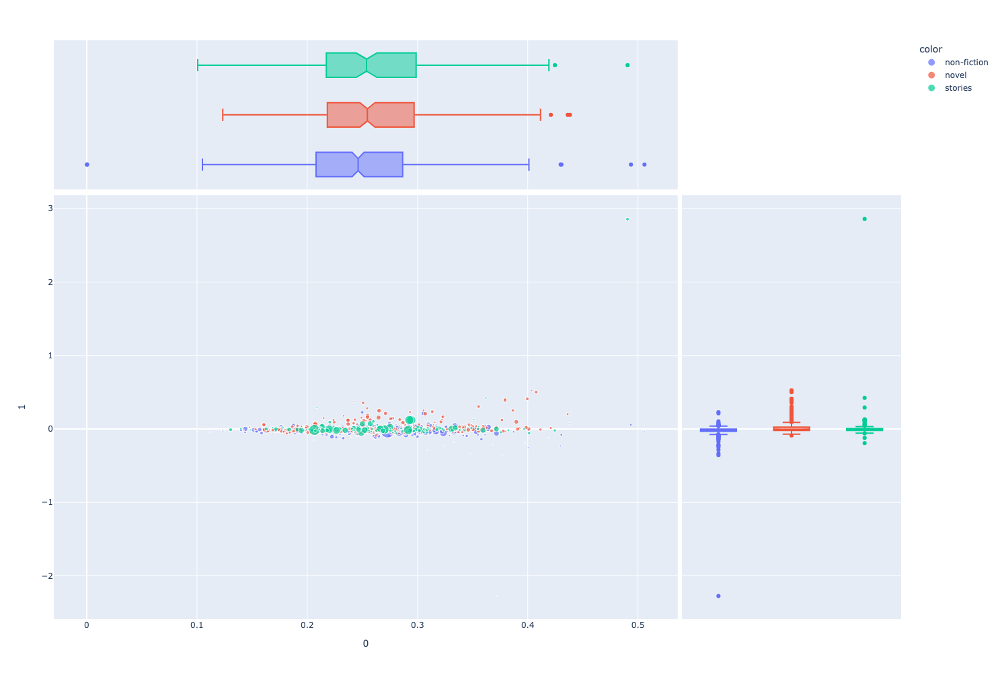

In [123]:
px.scatter(small_dcm, 0, 1, 
           color=small_chap_DOC.type,
           size=small_chap_DOC.n_tokens, hover_name=small_chap_DOC.label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

### **Prince PCA Method with Only 1000 Most Significant Words (`TFIDF_sigs`)**

In [124]:
pca_sigs = pca.fit(TFIDF_sigs)

In [125]:
dcm_sigs = pca_sigs.transform(TFIDF_sigs)

In [126]:
dcm_sigs

0         1         2         3         4         5
book_id chap_id                                                            
70      1        0.056153 -0.023210 -0.013009  0.004759 -0.005821  0.004595
        2        0.180922 -0.038227  0.022268 -0.039044 -0.009613  0.004492
        3        0.220261 -0.079028  0.039250  0.012342  0.013575 -0.047303
        4        0.133059 -0.036709 -0.007816  0.012793  0.007986  0.016466
        5        0.154748 -0.040718 -0.017498  0.031480  0.008514 -0.012437
...                   ...       ...       ...       ...       ...       ...
62739   2        0.168050 -0.050184 -0.021159  0.007675 -0.006063  0.012953
        3        0.159232 -0.048936  0.003923 -0.028582  0.020467  0.037295
        4        0.072618 -0.030855  0.001835  0.009470  0.000830  0.018404
        5        0.089742 -0.041856  0.026121 -0.001859 -0.024549  0.000448
        6        0.064286 -0.040945  0.010348  0.004402 -0.011561  0.000698

[1108 rows x 6 columns]

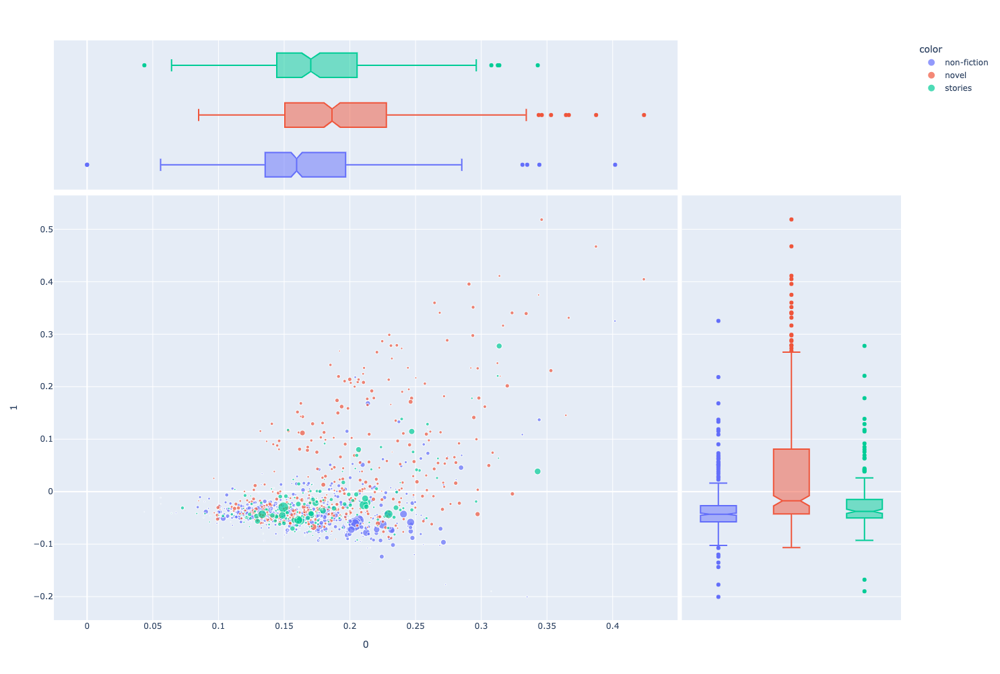

In [127]:
px.scatter(dcm_sigs, 0, 1, 
           color=chap_DOC.type,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

In [128]:
# save BOW for topic modeling

BOW.to_csv(f'twain_BOW.csv')

#### **Sources**

* `pandas.DataFrame.droplevel` to drop one or more levels of a `MultiIndex`: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.droplevel.html
* How to retrieve specific combinations of `MultiIndex` levels: https://stackoverflow.com/questions/52798386/pandas-dataframe-how-to-retrieve-specific-combinations-of-multiindex-levels
* Accessing data in a `MultiIndex`: https://towardsdatascience.com/accessing-data-in-a-multiindex-dataframe-in-pandas-569e8767201d
* `sklearn.metrics.silhouette_score`: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html
* Append a row as a list to a dataframe: https://sparkbyexamples.com/pandas/pandas-append-list-as-a-row-to-dataframe/
* pandas `background_gradient`: https://pandas.pydata.org/docs/reference/api/pandas.io.formats.style.Styler.background_gradient.html
* Deal with SettingWithCopyWarning in pandas: https://stackoverflow.com/questions/20625582/how-to-deal-with-settingwithcopywarning-in-pandas

In [143]:
LOADINGS.to_csv('twain_LOADINGS.csv')
DCM.to_csv('twain_DCM.csv')
COMPINF.to_csv('twain_COMPINF.csv')